In [1]:
# import relevant libraries
import numpy as np
import pandas as pd
import datetime as dt
import matplotlib.ticker as mtick
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
plt.style.use('ggplot')

# Data Preprocessing

In [2]:
# read csv file
data = pd.read_csv('data.csv')
data

,date,ticker,atr,bb_high,bb_low,bb_mid,garman_klass_vol,macd,rsi,1m_return,2m_return,3m_return,6m_return,9m_return,12m_return,Mkt-RF,SMB,HML,RMW,CMA
0,10/31/2017,AAL,1.011062,3.994389,3.849110,3.921750,-0.000363,-0.018697,41.051804,-0.014108,0.022981,-0.023860,0.016495,0.007008,0.012702,1.261817,1.306500,0.632023,0.507424,0.557001
1,10/31/2017,AAPL,-0.906642,3.692324,3.598569,3.645447,-0.000892,-0.039275,69.196794,0.096808,0.015250,0.044955,0.028875,0.038941,0.035228,1.280256,-0.272362,-0.609508,0.663831,0.487738
2,10/31/2017,ABBV,0.375557,4.307973,4.215227,4.261600,-0.029822,0.473814,55.247867,0.022728,0.098590,0.091379,0.056495,0.047273,0.044026,0.495965,0.376214,-0.016727,0.231811,0.123746
3,10/31/2017,ABT,-1.040044,3.949284,3.902136,3.925710,-0.004349,0.276132,53.844881,0.021275,0.034308,0.034801,0.038672,0.031320,0.029294,0.831881,-0.213284,-0.539413,0.236860,0.981359
4,10/31/2017,ACN,-0.986514,4.889486,4.810123,4.849805,-0.003359,0.352341,69.365427,0.064180,0.048455,0.037203,0.028692,0.027398,0.018728,1.197481,-0.157158,-0.330355,0.264166,0.179182
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10017,9/30/2023,VZ,-1.078816,3.563843,3.499366,3.531604,-0.000067,-0.350385,42.222474,-0.056890,-0.016122,-0.033458,-0.021495,-0.014100,-0.006158,0.518740,-0.365188,0.013464,0.313425,0.617455
10018,9/30/2023,WFC,-0.558742,3.798900,3.718132,3.758516,0.000234,-0.282325,40.920273,-0.015500,-0.057917,-0.013554,0.016712,0.000702,0.003255,1.093985,-0.140008,1.309152,-0.750924,-0.409060
10019,9/30/2023,WMT,-0.196379,5.116986,5.081613,5.099300,0.000024,0.399459,54.722508,-0.000676,0.010014,0.012354,0.017574,0.016553,0.020256,0.615232,-0.473891,-0.291126,0.409352,0.729465
10020,9/30/2023,XOM,0.601335,4.793504,4.713293,4.753399,0.000045,1.400623,59.440192,0.046947,0.046139,0.030496,0.012838,0.008747,0.027037,1.168320,0.387311,0.513399,-0.467914,0.799640


In [3]:
# check datatypes
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10022 entries, 0 to 10021
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   date              10022 non-null  object 
 1   ticker            10022 non-null  object 
 2   atr               10022 non-null  float64
 3   bb_high           10022 non-null  float64
 4   bb_low            10022 non-null  float64
 5   bb_mid            10022 non-null  float64
 6   garman_klass_vol  10022 non-null  float64
 7   macd              10022 non-null  float64
 8   rsi               10022 non-null  float64
 9   1m_return         10022 non-null  float64
 10  2m_return         10022 non-null  float64
 11  3m_return         10022 non-null  float64
 12  6m_return         10022 non-null  float64
 13  9m_return         10022 non-null  float64
 14  12m_return        10022 non-null  float64
 15  Mkt-RF            10022 non-null  float64
 16  SMB               10022 non-null  float6

In [4]:
# convert date to datetime
data['date'] = pd.to_datetime(data['date'])

# convert ticker to category
data['ticker'] = data['ticker'].astype('category')

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10022 entries, 0 to 10021
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   date              10022 non-null  datetime64[ns]
 1   ticker            10022 non-null  category      
 2   atr               10022 non-null  float64       
 3   bb_high           10022 non-null  float64       
 4   bb_low            10022 non-null  float64       
 5   bb_mid            10022 non-null  float64       
 6   garman_klass_vol  10022 non-null  float64       
 7   macd              10022 non-null  float64       
 8   rsi               10022 non-null  float64       
 9   1m_return         10022 non-null  float64       
 10  2m_return         10022 non-null  float64       
 11  3m_return         10022 non-null  float64       
 12  6m_return         10022 non-null  float64       
 13  9m_return         10022 non-null  float64       
 14  12m_return        1002

In [5]:
# set date and ticker as index
data = data.set_index(['date', 'ticker'])
data

atr   bb_high    bb_low    bb_mid  garman_klass_vol  \
date       ticker                                                             
2017-10-31 AAL     1.011062  3.994389  3.849110  3.921750         -0.000363   
           AAPL   -0.906642  3.692324  3.598569  3.645447         -0.000892   
           ABBV    0.375557  4.307973  4.215227  4.261600         -0.029822   
           ABT    -1.040044  3.949284  3.902136  3.925710         -0.004349   
           ACN    -0.986514  4.889486  4.810123  4.849805         -0.003359   
...                     ...       ...       ...       ...               ...   
2023-09-30 VZ     -1.078816  3.563843  3.499366  3.531604         -0.000067   
           WFC    -0.558742  3.798900  3.718132  3.758516          0.000234   
           WMT    -0.196379  5.116986  5.081613  5.099300          0.000024   
           XOM     0.601335  4.793504  4.713293  4.753399          0.000045   
           MRNA   -0.529511  4.788149  4.582514  4.685332          0.000146   

                       macd        rsi  1m_return  2m_return  3m_return  \
date       ticker                                                         
2017-10-31 AAL    -0.018697  41.051804  -0.014108   0.022981  -0.023860   
           AAPL   -0.039275  69.196794   0.096808   0.015250   0.044955   
           ABBV    0.473814  55.247867   0.022728   0.098590   0.091379   
           ABT     0.276132  53.844881   0.021275   0.034308   0.034801   
           ACN     0.352341  69.365427   0.064180   0.048455   0.037203   
...                     ...        ...        ...        ...        ...   
2023-09-30 VZ     -0.350385  42.222474  -0.056890  -0.016122  -0.033458   
           WFC    -0.282325  40.920273  -0.015500  -0.057917  -0.013554   
           WMT     0.399459  54.722508  -0.000676   0.010014   0.012354   
           XOM     1.400623  59.440192   0.046947   0.046139   0.030496   
           MRNA   -0.376899  38.747314  -0.132219  -0.086803  -0.068763   

                   6m_return  9m_return  12m_return    Mkt-RF       SMB  \
date       ticker                                                         
2017-10-31 AAL      0.016495   0.007008    0.012702  1.261817  1.306500   
           AAPL     0.028875   0.038941    0.035228  1.280256 -0.272362   
           ABBV     0.056495   0.047273    0.044026  0.495965  0.376214   
           ABT      0.038672   0.031320    0.029294  0.831881 -0.213284   
           ACN      0.028692   0.027398    0.018728  1.197481 -0.157158   
...                      ...        ...         ...       ...       ...   
2023-09-30 VZ      -0.021495  -0.014100   -0.006158  0.518740 -0.365188   
           WFC      0.016712   0.000702    0.003255  1.093985 -0.140008   
           WMT      0.017574   0.016553    0.020256  0.615232 -0.473891   
           XOM      0.012838   0.008747    0.027037  1.168320  0.387311   
           MRNA    -0.071952  -0.064976   -0.015431  1.301327 -0.186763   

                        HML       RMW       CMA  
date       ticker                                
2017-10-31 AAL     0.632023  0.507424  0.557001  
           AAPL   -0.609508  0.663831  0.487738  
           ABBV   -0.016727  0.231811  0.123746  
           ABT    -0.539413  0.236860  0.981359  
           ACN    -0.330355  0.264166  0.179182  
...                     ...       ...       ...  
2023-09-30 VZ      0.013464  0.313425  0.617455  
           WFC     1.309152 -0.750924 -0.409060  
           WMT    -0.291126  0.409352  0.729465  
           XOM     0.513399 -0.467914  0.799640  
           MRNA   -1.183057  1.125993  0.527068  

[10022 rows x 18 columns]

In [6]:
# create list to store variables
variables = list(data.columns)
variables

['atr',
 'bb_high',
 'bb_low',
 'bb_mid',
 'garman_klass_vol',
 'macd',
 'rsi',
 '1m_return',
 '2m_return',
 '3m_return',
 '6m_return',
 '9m_return',
 '12m_return',
 'Mkt-RF',
 'SMB',
 'HML',
 'RMW',
 'CMA']

# K-Means Clustering Algorithm

## For each month fit K-Means Clustering Algorithm to group similar assets based on their features. Reiterate with different number of clusters from k=3 to 9

In [7]:
from sklearn.preprocessing import StandardScaler
def data_preprocessing(df, col_name):
    """
    Scale a specific column in the DataFrame using StandardScaler.
    Parameters:
    - df (DataFrame): The input DataFrame containing the data to be scaled.
    - col_name (str): The name of the column to be scaled.
    Returns:
    - scaled_column (ndarray): A numpy array containing the scaled values of the specified column.
    """
    # Create a StandardScaler object that will perform the scaling
    scaler = StandardScaler()
    # Scale the specified column in the DataFrame
    scaled_column = scaler.fit_transform(df[[col_name]])
    
    return scaled_column

In [8]:
from sklearn.cluster import KMeans
def perform_clustering(data, num_clusters):
    """
    Perform clustering on the input dataset based on the specified number of clusters.
    Parameters:
    - data (DataFrame): The input dataset containing the data to be clustered.
    - num_clusters (int): The number of clusters to create.
    Returns:
    - clustered_data (DataFrame): A DataFrame containing the original data with an additional 'cluster_<num_clusters>'
      column indicating the cluster assignment for each data point.
    """
    def get_clusters(df, num_clusters):
        mean = df['rsi'].mean()
        std = df['rsi'].std()
        
        # Define target RSI values based on the number of clusters
        target_rsi_values = [30 + i * (40 / (num_clusters - 1)) for i in range(num_clusters)]
        
        # Standardize initial RSI values
        target_rsi_values = [(x - mean) / std for x in target_rsi_values]
        
        # Create initial centroids
        initial_centroids = np.zeros((len(target_rsi_values), 18))
        initial_centroids[:, 6] = target_rsi_values
        
        # Scale variables
        variables = df.columns
        for var in variables:
            df[var] = data_preprocessing(df, var)
        
        # Perform clustering
        df[f'cluster_{num_clusters}'] = KMeans(n_clusters=num_clusters, random_state=0, init=initial_centroids).fit(df[variables]).labels_
        return df
    
    data_copy = data.copy().dropna()
    data_clustered = data_copy.groupby('date', group_keys=False).apply(get_clusters, num_clusters)
    
    return data_clustered

In [9]:
def plot_clusters_by_date(num_clusters):
    """
    Plot clusters by date for a specific number of clusters.
    Parameters:
    - num_clusters (int): The number of clusters to plot (3 to 9).
    Returns:
    - None: Displays the scatter plot for each date.
    """
    data = globals()[f'data_{num_clusters}']  # Get the appropriate DataFrame based on num_clusters
    colors = ['red', 'green', 'blue', 'orange', 'purple', 'pink', 'black', 'brown', 'hotpink']

    for date in data.index.get_level_values('date').unique().tolist():
        subset_data = data.xs(date, level=0)
        plt.title(f'Date {date}')
        for i in range(num_clusters):
            cluster_data = subset_data[subset_data[f'cluster_{num_clusters}'] == i]
            plt.scatter(cluster_data.iloc[:, 0], cluster_data.iloc[:, 6], color=colors[i], label=f'Cluster {i}')

        plt.legend()
        plt.xlabel('ATR')  
        plt.ylabel('RSI')  
        plt.show()

In [10]:
def extract_highest_rsi_clusters_each_month(num_clusters):
    """
    Extract the cluster with the highest mean RSI for each date in the DataFrame.
    Parameters:
    - num_clusters (int): The number of clusters (3 to 9).
    Returns:
    - dict: A dictionary where keys are dates and values are lists of selected stocks in the highest mean RSI cluster.
    """

    # Get the appropriate DataFrame based on num_clusters
    data = globals()[f'data_{num_clusters}']

    # Reset the index and adjust the date by one day
    temp_df = data.reset_index()
    temp_df['date'] = temp_df['date'] + pd.DateOffset(1)
    
    # Get unique dates and initialize the result dictionary
    dates = pd.to_datetime(temp_df['date'].unique()).tolist()
    fixed_dates = {}

    for date in dates:
        # Filter the DataFrame for the current date
        filtered_df = temp_df[temp_df['date'] == date]
        cluster_column = f'cluster_{num_clusters}'
        rsi_column = 'rsi'
        # Calculate the mean RSI for each cluster on the current date
        cluster_means = filtered_df.groupby(cluster_column)[rsi_column].mean()
        # Find the cluster with the highest mean RSI
        highest_mean_cluster = cluster_means.idxmax()
        # Select the stocks in the highest mean RSI cluster
        selected_stocks = filtered_df[filtered_df[cluster_column] == highest_mean_cluster]['ticker']
        # Store the selected stocks in the result dictionary
        fixed_dates[date.strftime('%Y-%m-%d')] = list(selected_stocks)
    print(fixed_dates)

    return fixed_dates

### Set k = 3, RSI values = [30, 50, 70]

In [11]:
# Perform clustering with 3 clusters
data_3 = perform_clustering(data, 3)

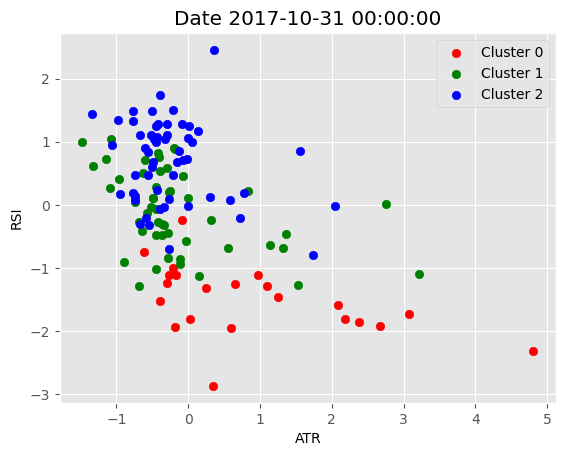

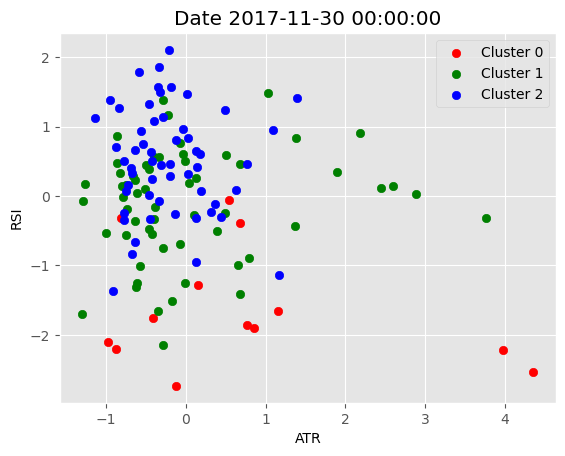

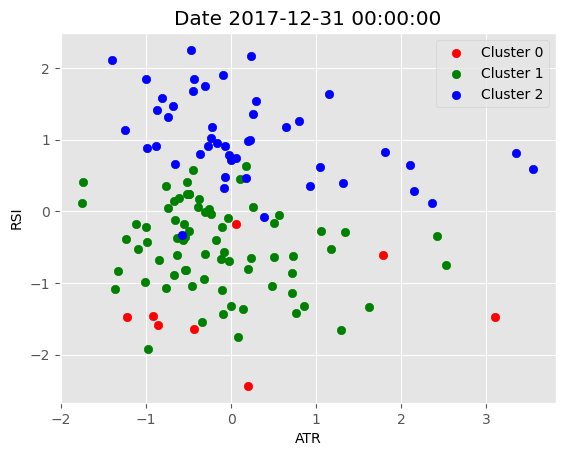

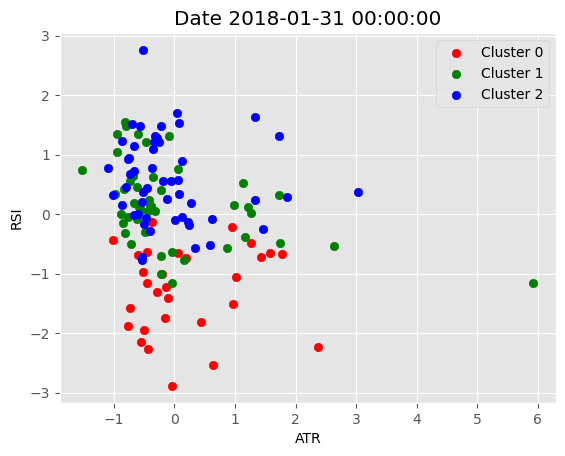

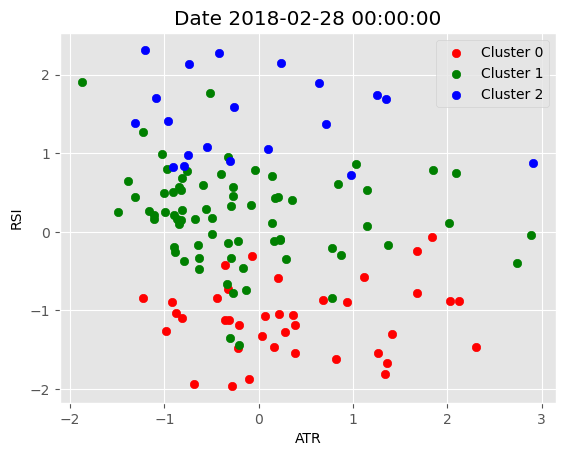

...

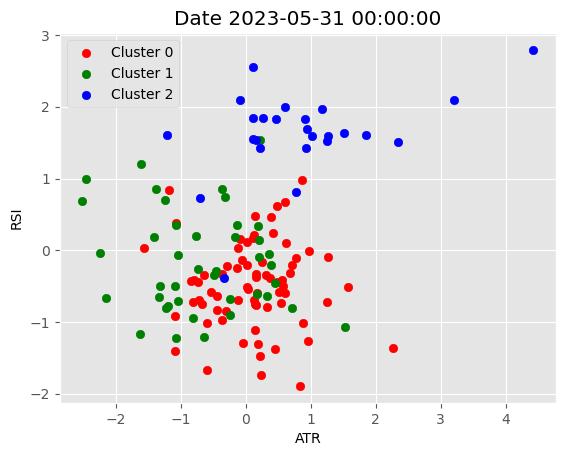

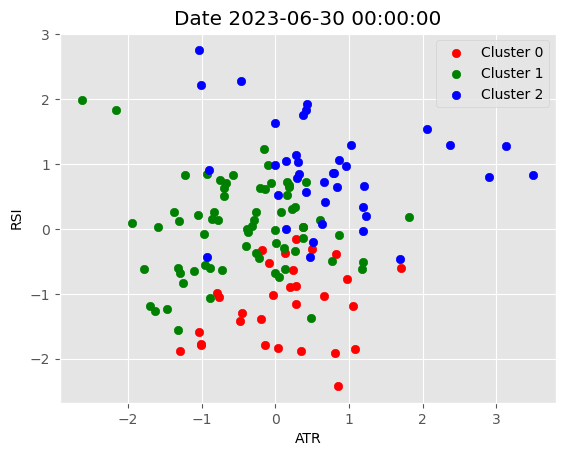

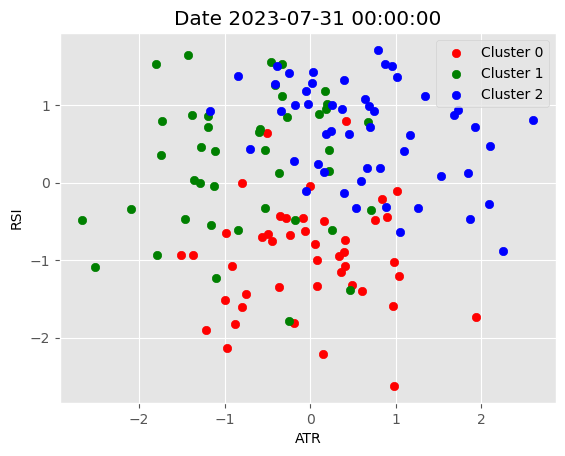

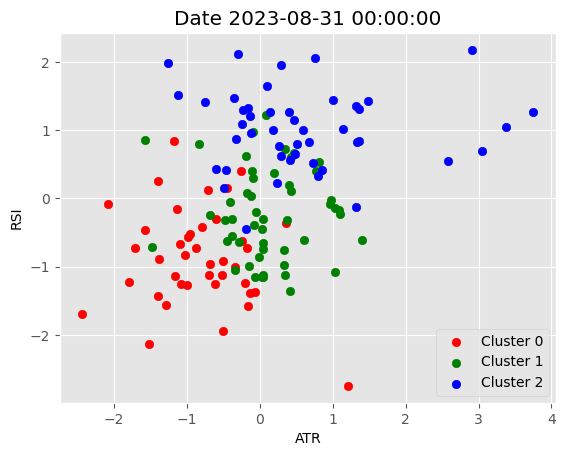

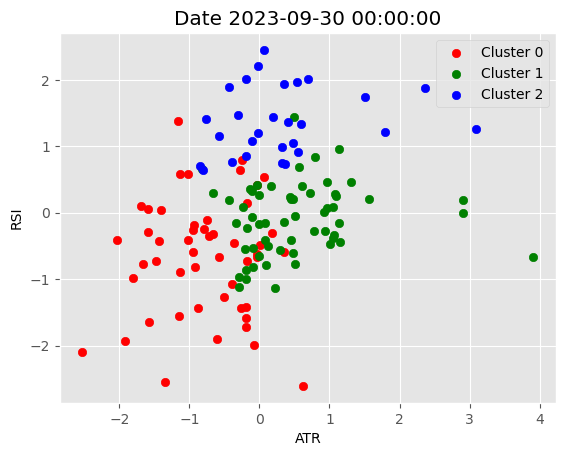

In [12]:
# Plot clusters
plot_clusters_by_date(num_clusters=3)

In [13]:
# Extract the cluster with the highest mean RSI for each month:
date_to_optimize_3 = extract_highest_rsi_clusters_each_month(num_clusters=3)

{'2017-11-01': ['AAPL', 'ABBV', 'ACN', 'ADBE', 'AMAT', 'AMZN', 'AVGO', 'AXP', 'AZO', 'BA', 'BIIB', 'BKNG', 'BRK-B', 'CAT', 'CRM', 'CTSH', 'DD', 'DE', 'DG', 'DHR', 'DLTR', 'EA', 'ELV', 'FDX', 'GM', 'GS', 'HD', 'HON', 'HUM', 'ILMN', 'INTC', 'ISRG', 'JNJ', 'JPM', 'LMT', 'MA', 'MAR', 'MCD', 'META', 'MMM', 'MSFT', 'MU', 'NFLX', 'NVDA', 'NXPI', 'PYPL', 'SHW', 'STZ', 'TMO', 'TXN', 'UNH', 'UNP', 'V', 'WMT', 'WYNN'], '2017-12-01': ['ABBV', 'ABT', 'ACN', 'ADBE', 'AMZN', 'AVGO', 'AXP', 'AZO', 'BA', 'BIIB', 'BRK-B', 'CAT', 'COST', 'CRM', 'DD', 'DE', 'DG', 'DHR', 'DLTR', 'ELV', 'FDX', 'GS', 'HD', 'HON', 'HUM', 'ILMN', 'INTC', 'ISRG', 'JNJ', 'JPM', 'LMT', 'LOW', 'MA', 'MAR', 'MCD', 'META', 'MMM', 'MSFT', 'MU', 'NFLX', 'NKE', 'NVDA', 'ORLY', 'PEP', 'PYPL', 'QCOM', 'SHW', 'STZ', 'TMO', 'TXN', 'UNH', 'UNP', 'V', 'VLO', 'WMT', 'WYNN'], '2018-01-01': ['AAL', 'ACN', 'AZO', 'BA', 'BAC', 'CAT', 'CMCSA', 'COP', 'CSCO', 'CVX', 'DAL', 'DE', 'DG', 'DIS', 'DLTR', 'EOG', 'FCX', 'FDX', 'HAL', 'HD', 'INTC', 'JPM', 

### Set k = 4, RSI values = [30, 30 + 40/3, 30 + 40*2/3, 70]

In [14]:
# Perform clustering with 4 clusters
data_4 = perform_clustering(data, 4)

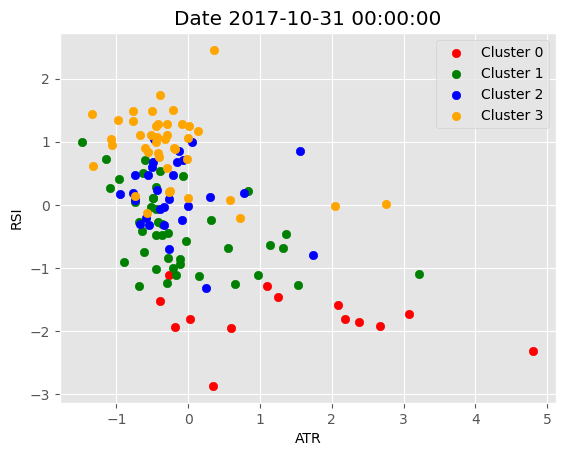

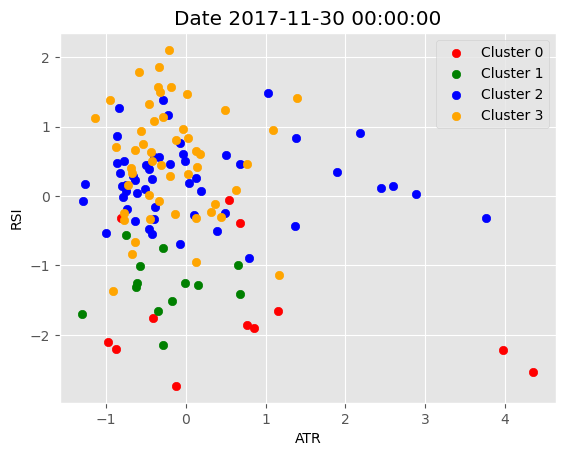

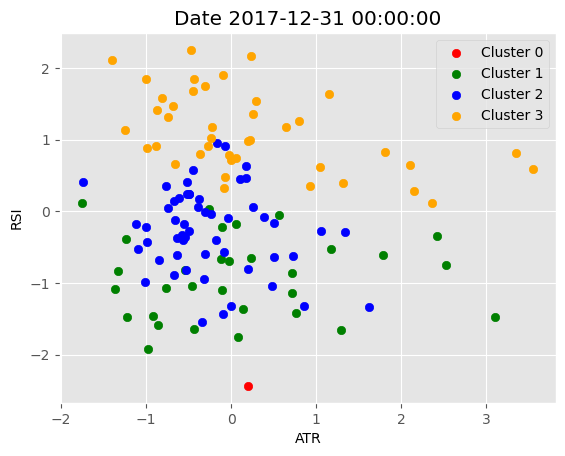

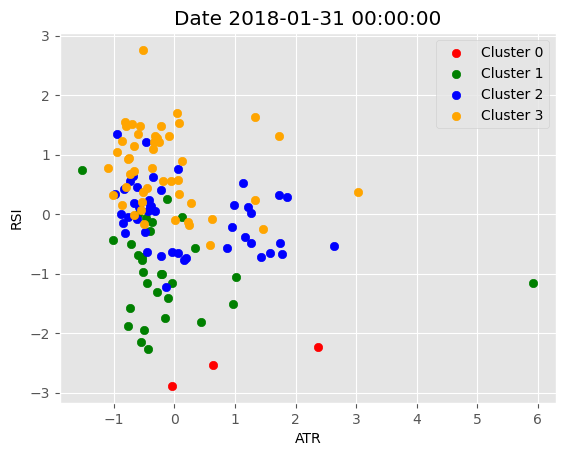

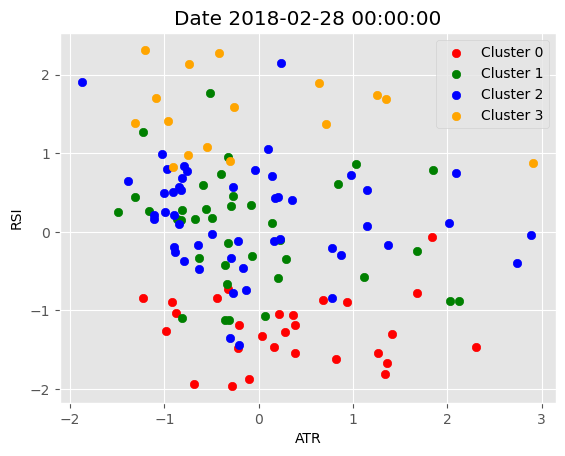

...

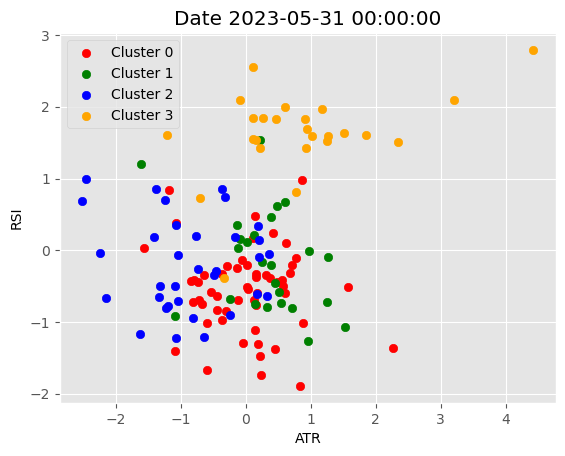

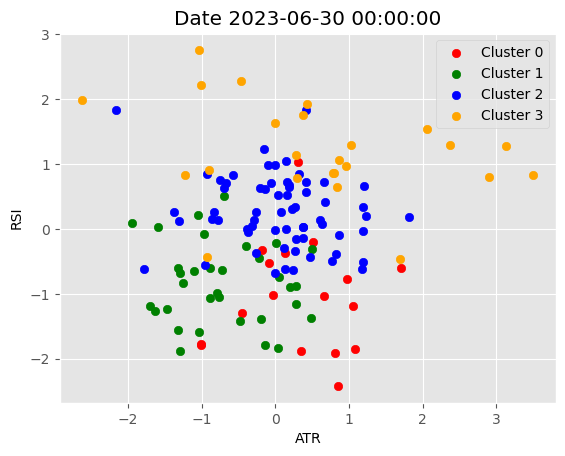

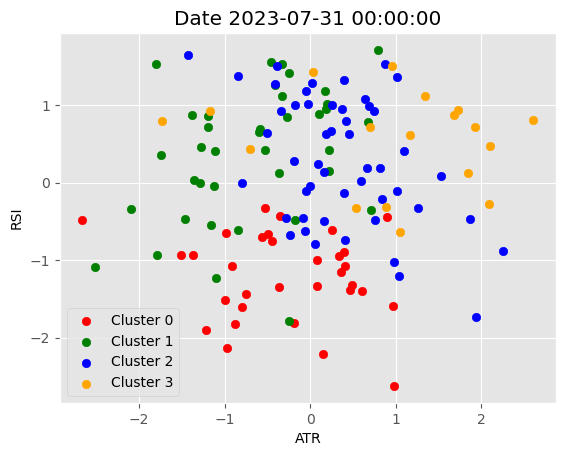

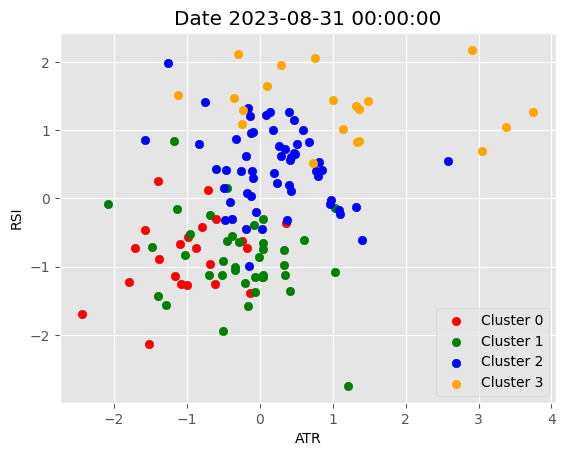

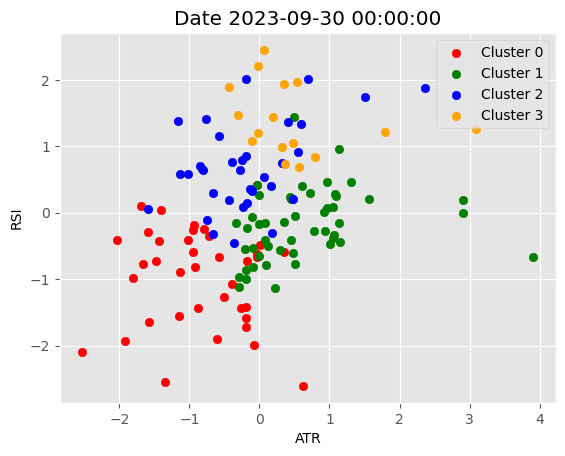

In [15]:
# Plot clusters
plot_clusters_by_date(num_clusters=4)

In [16]:
# Extract the cluster with the highest mean RSI for each month:
date_to_optimize_4 = extract_highest_rsi_clusters_each_month(num_clusters=4)

{'2017-11-01': ['AAPL', 'ABBV', 'ABT', 'ADBE', 'AMAT', 'AMZN', 'AXP', 'BAC', 'C', 'CAT', 'CRM', 'CTSH', 'DE', 'DHR', 'GM', 'GOOG', 'GOOGL', 'INTC', 'ISRG', 'JPM', 'MA', 'MAR', 'MET', 'MS', 'MSFT', 'MU', 'NEE', 'NFLX', 'NVDA', 'NXPI', 'ORCL', 'PYPL', 'SCHW', 'SHW', 'STZ', 'TXN', 'V', 'VLO', 'WDC', 'WMT', 'WYNN'], '2017-12-01': ['ABBV', 'ACN', 'ADBE', 'AMZN', 'AVGO', 'AXP', 'AZO', 'BA', 'BIIB', 'BRK-B', 'CAT', 'COST', 'CRM', 'DD', 'DE', 'DG', 'DLTR', 'ELV', 'FDX', 'GS', 'HD', 'HON', 'HUM', 'ILMN', 'ISRG', 'JNJ', 'JPM', 'LMT', 'MA', 'MAR', 'MCD', 'META', 'MMM', 'MSFT', 'MU', 'NFLX', 'NVDA', 'ORLY', 'PYPL', 'QCOM', 'SHW', 'STZ', 'TMO', 'TXN', 'UNH', 'UNP', 'V', 'VLO', 'WMT', 'WYNN'], '2018-01-01': ['AAL', 'AZO', 'BA', 'BAC', 'CAT', 'CMCSA', 'COP', 'CSCO', 'CVX', 'DAL', 'DE', 'DG', 'DLTR', 'EOG', 'FCX', 'FDX', 'HAL', 'HD', 'INTC', 'KR', 'LOW', 'LUV', 'MAR', 'MO', 'NKE', 'OXY', 'PXD', 'RTX', 'SCHW', 'SLB', 'STZ', 'T', 'TGT', 'TXN', 'UAL', 'UNP', 'VLO', 'VZ', 'WFC', 'WMT', 'WYNN'], '2018-02-0

### Set k = 5, RSI values = [30, 40, 50, 60, 70]

In [17]:
# Perform clustering with 5 clusters
data_5 = perform_clustering(data, 5)

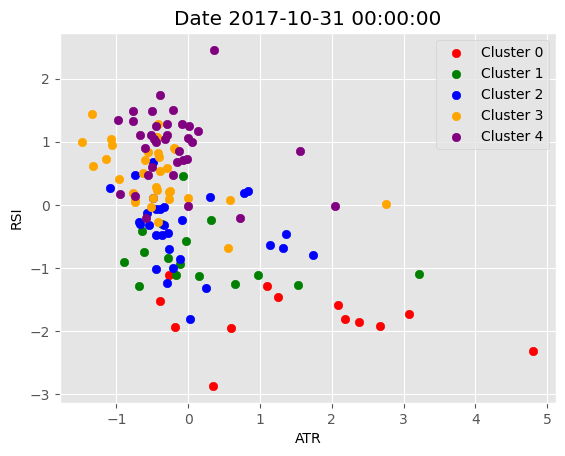

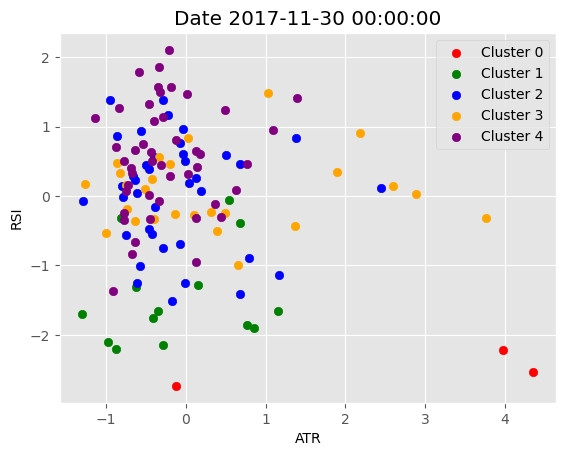

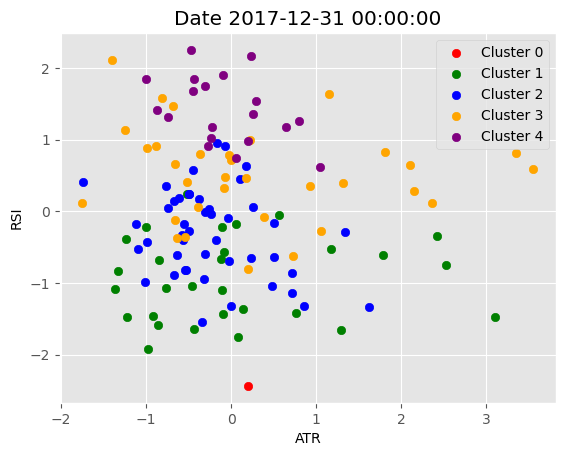

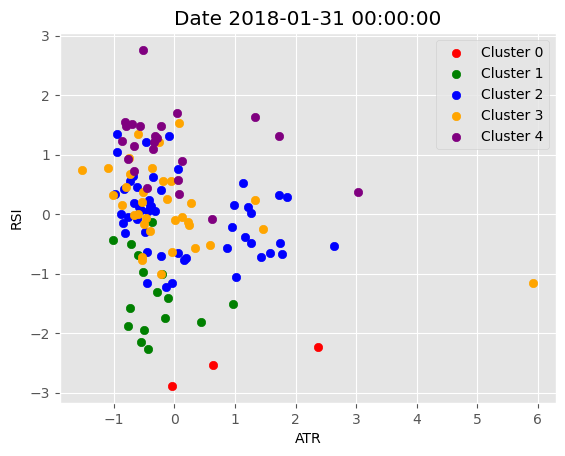

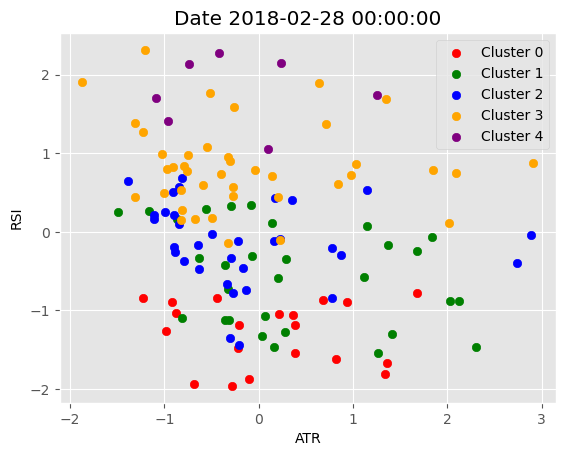

...

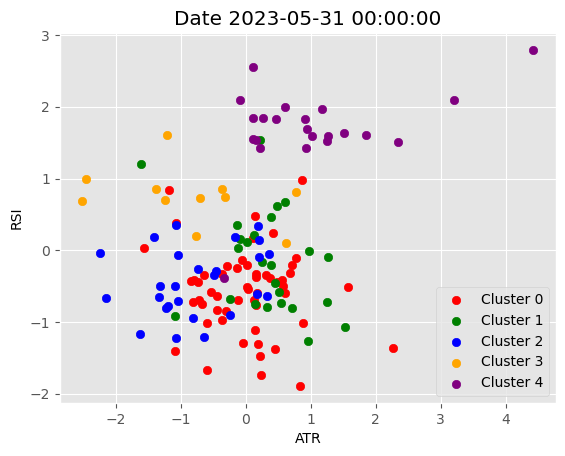

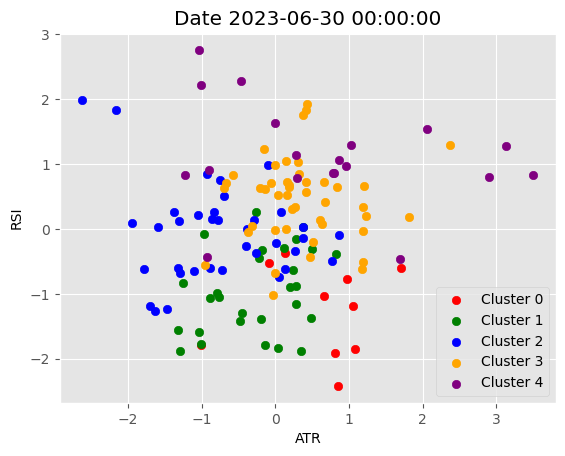

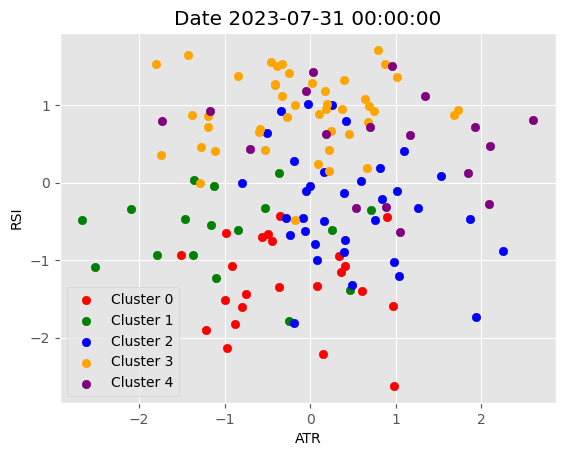

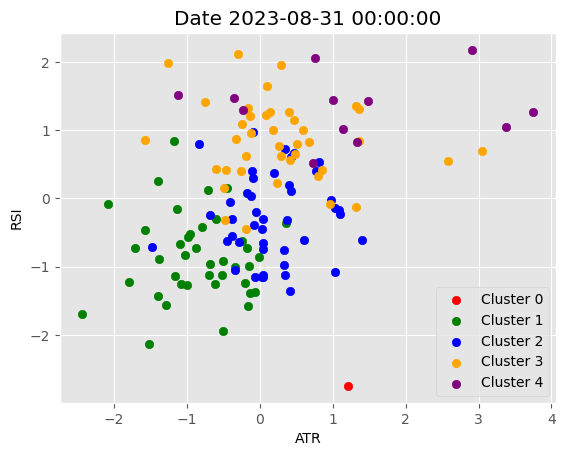

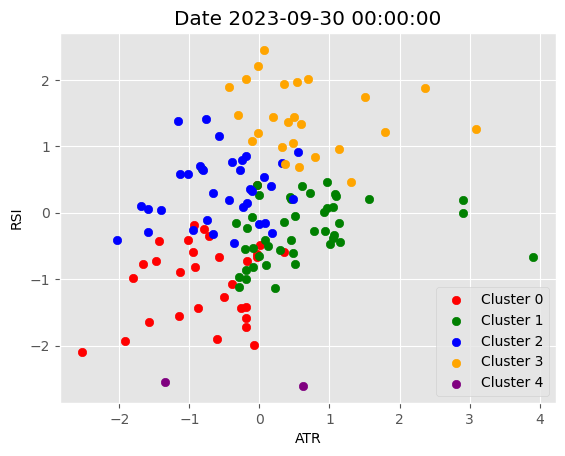

In [18]:
# Plot clusters
plot_clusters_by_date(num_clusters=5)

In [19]:
# Extract the cluster with the highest mean RSI for each month:
date_to_optimize_5 = extract_highest_rsi_clusters_each_month(num_clusters=5)

{'2017-11-01': ['AAPL', 'ABBV', 'ACN', 'ADBE', 'AMAT', 'AMZN', 'AVGO', 'BA', 'BKNG', 'CAT', 'CRM', 'DD', 'DE', 'ELV', 'FDX', 'GM', 'HUM', 'INTC', 'ISRG', 'MA', 'MAR', 'MCD', 'META', 'MMM', 'MSFT', 'MU', 'NFLX', 'NVDA', 'PYPL', 'SHW', 'STZ', 'TXN', 'UNH', 'V', 'WMT'], '2017-12-01': ['ABBV', 'ABT', 'ACN', 'ADBE', 'AMZN', 'AVGO', 'AZO', 'BA', 'BIIB', 'BRK-B', 'CAT', 'COST', 'CRM', 'DE', 'DG', 'DHR', 'DLTR', 'ELV', 'FDX', 'GS', 'HD', 'HON', 'HUM', 'ILMN', 'ISRG', 'LMT', 'MA', 'MAR', 'MCD', 'META', 'MMM', 'MSFT', 'NFLX', 'NKE', 'NVDA', 'PYPL', 'QCOM', 'SHW', 'STZ', 'TMO', 'TXN', 'UNH', 'UNP', 'V', 'WMT', 'WYNN'], '2018-01-01': ['AZO', 'BA', 'CAT', 'DE', 'DG', 'DLTR', 'FCX', 'FDX', 'HD', 'LOW', 'LUV', 'MAR', 'PXD', 'STZ', 'TXN', 'UNP', 'VLO', 'WMT', 'WYNN'], '2018-02-01': ['ABBV', 'ABT', 'ADBE', 'AMZN', 'BA', 'CAT', 'DG', 'DLTR', 'EA', 'GOOG', 'GOOGL', 'ISRG', 'LOW', 'MA', 'MAR', 'MSFT', 'NFLX', 'NKE', 'NVDA', 'PYPL', 'TGT', 'TMO', 'WMT'], '2018-03-01': ['ADBE', 'AMZN', 'BA', 'BKNG', 'LMT', 

### Set k = 6, RSI values = [30, 38, 46, 54, 62, 70]

In [20]:
# Perform clustering with 6 clusters
data_6 = perform_clustering(data, 6)

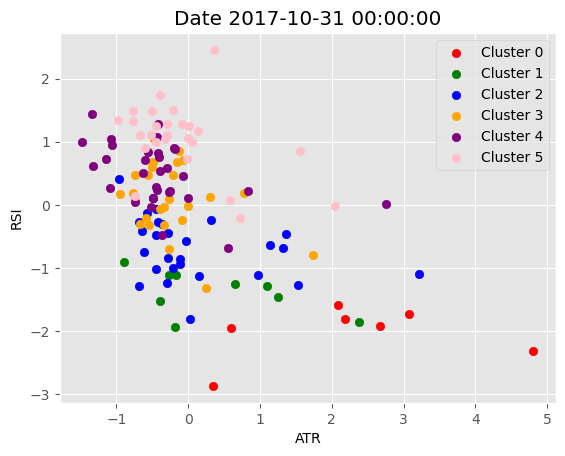

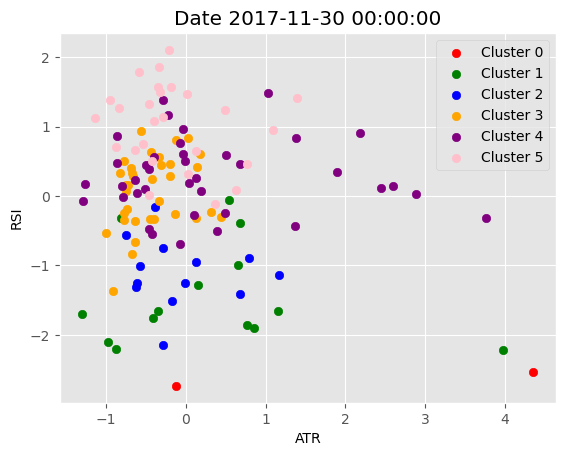

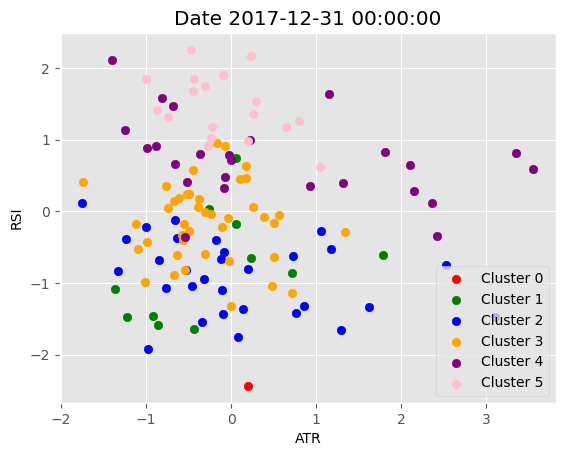

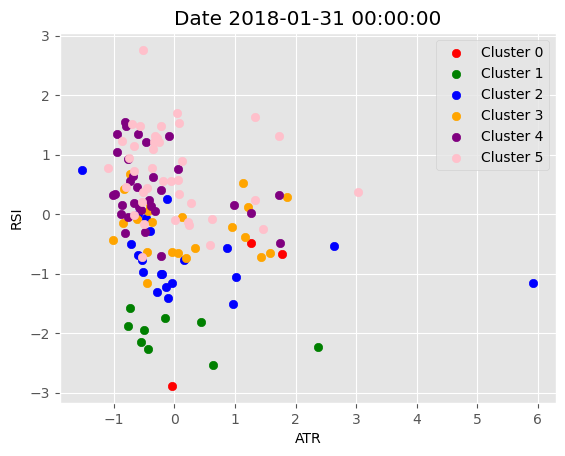

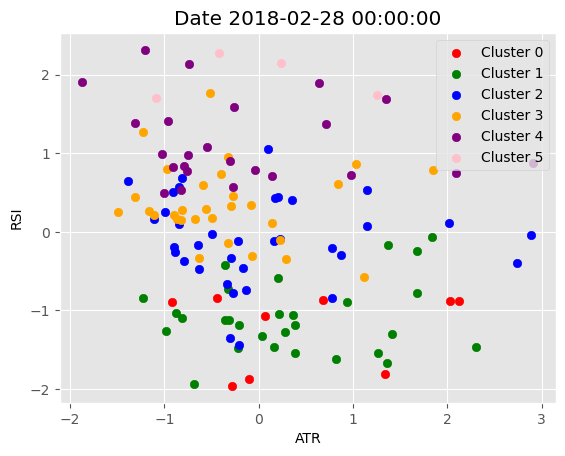

...

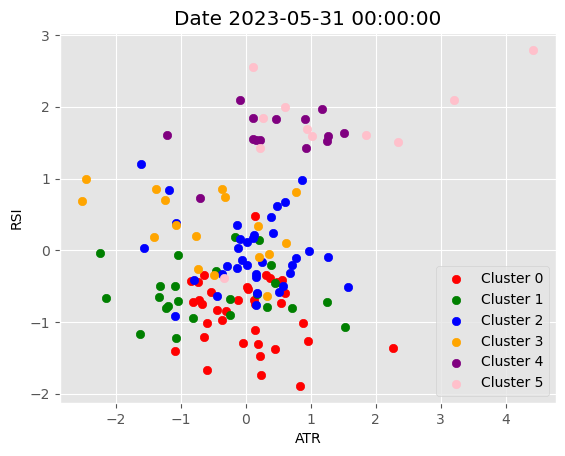

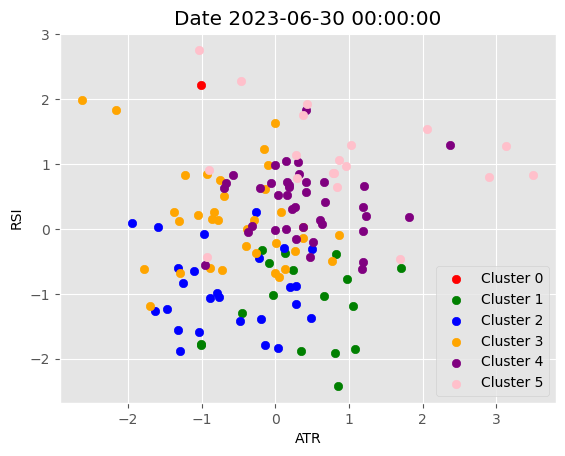

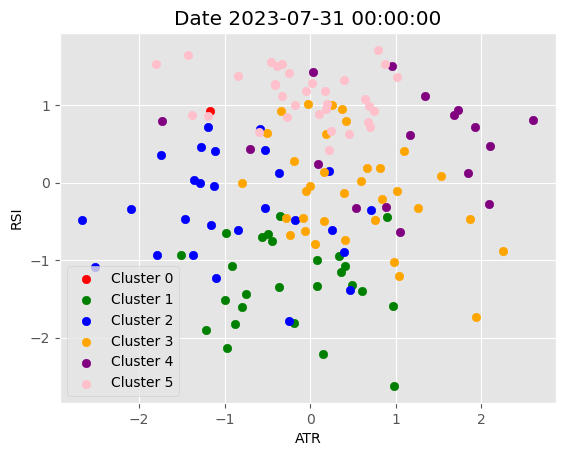

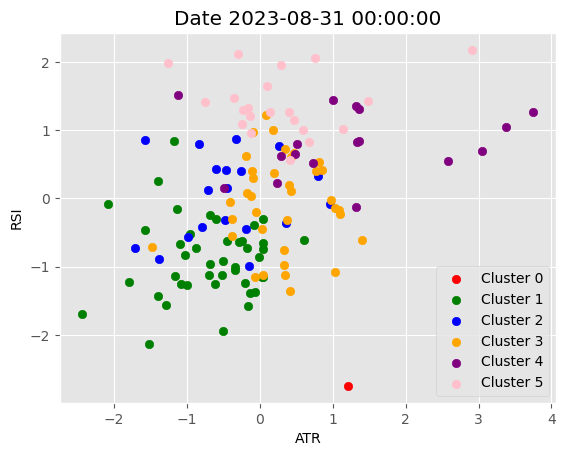

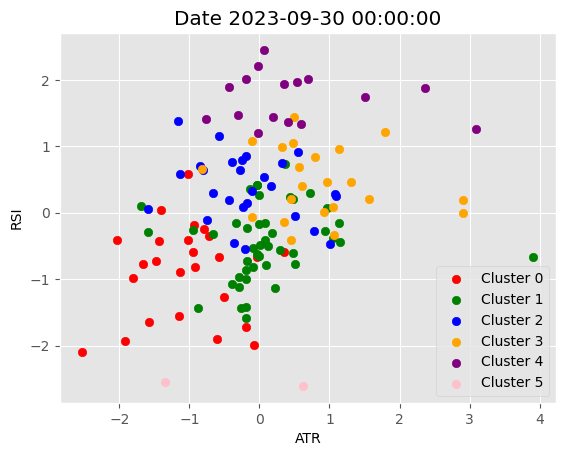

In [21]:
# Plot clusters
plot_clusters_by_date(num_clusters=6)

In [22]:
# Extract the cluster with the highest mean RSI for each month:
date_to_optimize_6 = extract_highest_rsi_clusters_each_month(num_clusters=6)

{'2017-11-01': ['AAPL', 'ABBV', 'ADBE', 'AMAT', 'AMZN', 'CAT', 'CRM', 'DE', 'ELV', 'GM', 'INTC', 'ISRG', 'MA', 'MAR', 'MMM', 'MSFT', 'MU', 'NFLX', 'NVDA', 'PYPL', 'SHW', 'STZ', 'TXN', 'V', 'WMT', 'WYNN'], '2017-12-01': ['ABBV', 'ADBE', 'AMZN', 'AVGO', 'AZO', 'BA', 'CAT', 'COST', 'DE', 'DG', 'DLTR', 'ELV', 'HD', 'HON', 'ILMN', 'ISRG', 'MAR', 'MMM', 'NKE', 'PYPL', 'QCOM', 'UNH', 'UNP', 'VLO', 'WMT', 'WYNN'], '2018-01-01': ['BA', 'CAT', 'DE', 'DG', 'DLTR', 'FCX', 'FDX', 'HD', 'LOW', 'LUV', 'MAR', 'PXD', 'STZ', 'TXN', 'UNP', 'VLO', 'WMT', 'WYNN'], '2018-02-01': ['ABBV', 'ABT', 'ACN', 'ADBE', 'AMZN', 'AZO', 'BA', 'BIIB', 'BRK-B', 'CAT', 'CHTR', 'COST', 'CRM', 'DE', 'DG', 'DLTR', 'EA', 'ELV', 'FDX', 'HD', 'HUM', 'ILMN', 'ISRG', 'LMT', 'LOW', 'MA', 'MAR', 'MCK', 'MMM', 'MSFT', 'NFLX', 'NVDA', 'ORLY', 'PYPL', 'TGT', 'TMO', 'TXN', 'UNH', 'V', 'WMT'], '2018-03-01': ['ADBE', 'BA', 'BKNG', 'NFLX'], '2018-04-01': ['NFLX'], '2018-05-01': ['CMG', 'COP', 'EOG', 'HAL', 'OXY', 'PXD', 'ULTA', 'VLO', 'WYN

### Set k = 7, RSI values = [30, 30 + 40/6, 30 + 40*2/6, ... , 70]

In [23]:
# Perform clustering with 7 clusters
data_7 = perform_clustering(data, 7)

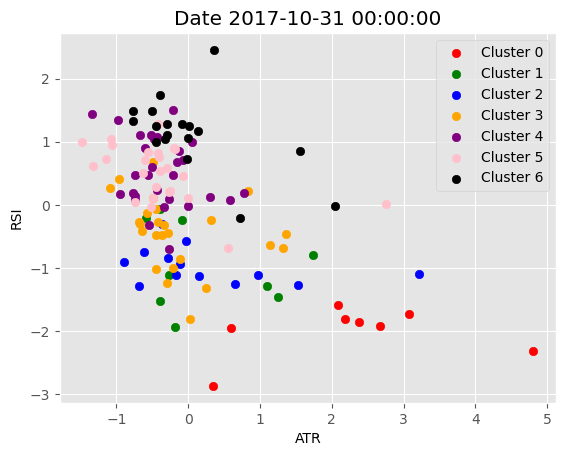

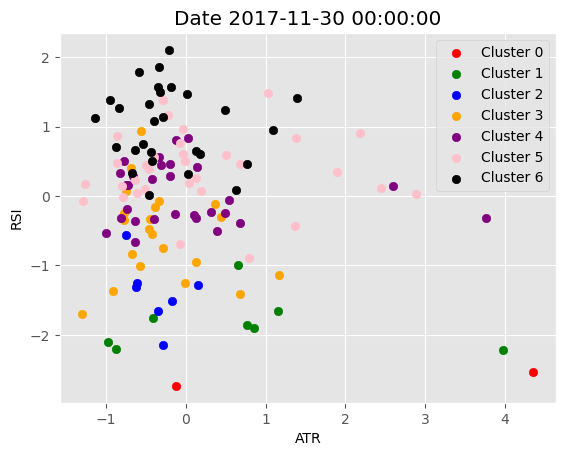

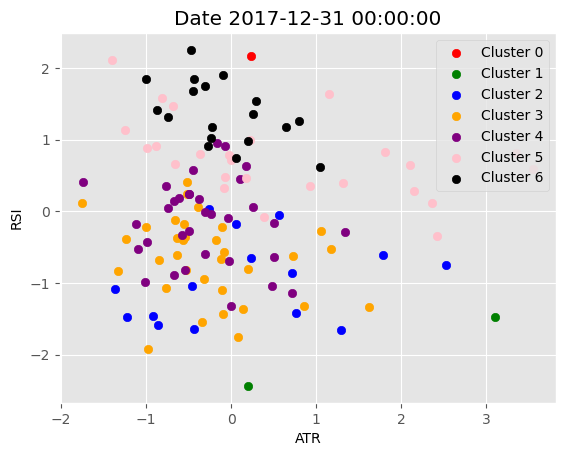

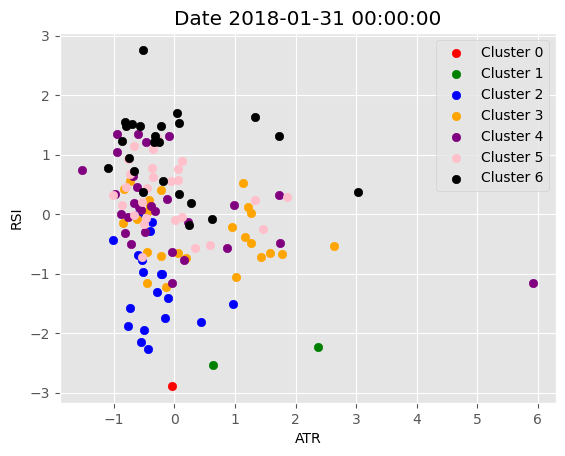

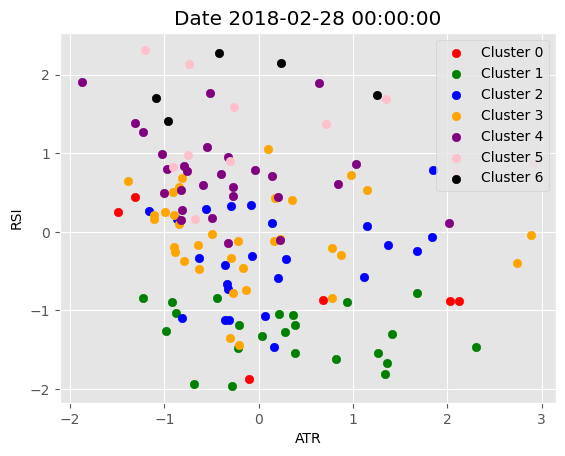

...

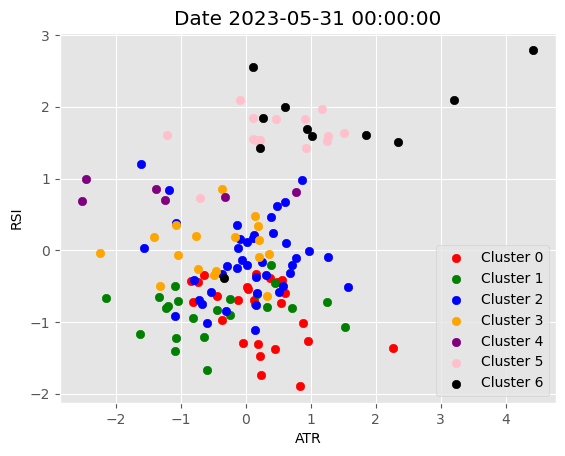

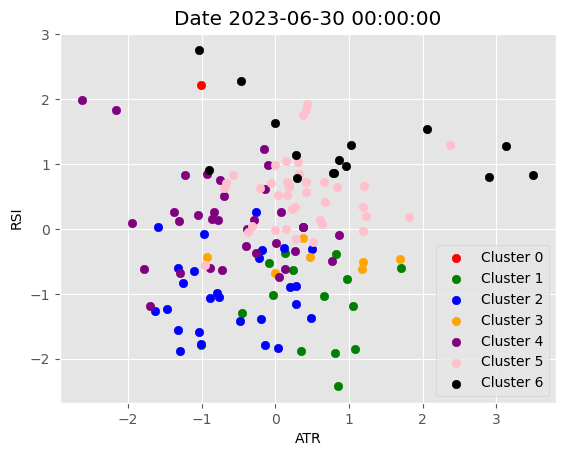

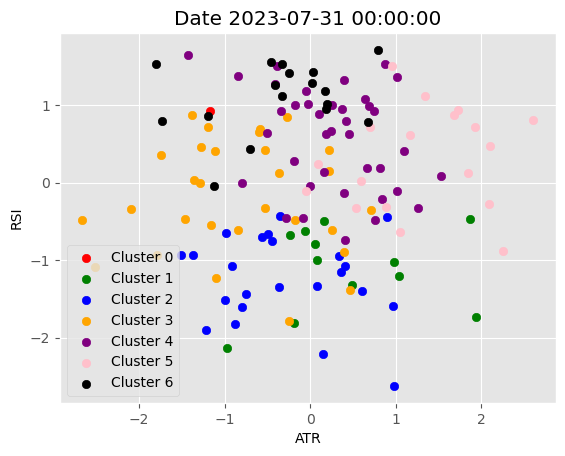

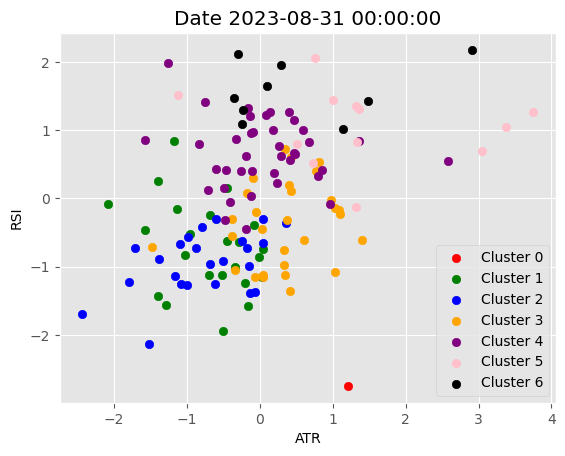

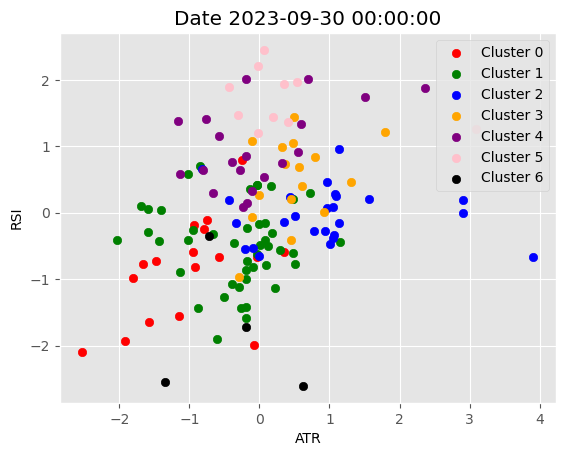

In [24]:
# Plot clusters
plot_clusters_by_date(num_clusters=7)

In [25]:
# Extract the cluster with the highest mean RSI for each month:
date_to_optimize_7 = extract_highest_rsi_clusters_each_month(num_clusters=7)

{'2017-11-01': ['AAPL', 'ABBV', 'ADBE', 'AMAT', 'AMZN', 'CAT', 'GM', 'INTC', 'ISRG', 'MAR', 'MMM', 'MSFT', 'MU', 'NVDA', 'PYPL', 'SHW', 'TXN', 'WMT'], '2017-12-01': ['ABBV', 'ACN', 'ADBE', 'AMZN', 'AVGO', 'AZO', 'BA', 'CAT', 'COST', 'DE', 'DG', 'DLTR', 'ELV', 'HD', 'HON', 'ILMN', 'ISRG', 'MAR', 'MCD', 'MMM', 'NKE', 'QCOM', 'SHW', 'UNH', 'UNP', 'VLO', 'WMT', 'WYNN'], '2018-01-01': ['FCX'], '2018-02-01': ['ABBV', 'ADBE', 'AMZN', 'BA', 'BRK-B', 'CAT', 'CRM', 'DE', 'EA', 'ELV', 'FDX', 'GOOG', 'GOOGL', 'HUM', 'ISRG', 'LMT', 'MA', 'MAR', 'MSFT', 'NFLX', 'NVDA', 'PYPL', 'TMO', 'V'], '2018-03-01': ['ADBE', 'BA', 'BKNG', 'MA', 'NFLX'], '2018-04-01': ['ADBE', 'AMZN', 'BKNG', 'CRM', 'CTSH', 'INTC', 'MA', 'MU', 'NVDA', 'PANW', 'STZ', 'WDC', 'WYNN'], '2018-05-01': ['CMG', 'COP', 'CVX', 'EOG', 'HAL', 'OXY', 'PXD', 'ULTA', 'VLO'], '2018-06-01': ['AMD', 'COP', 'CSX', 'EOG', 'GM', 'INTC', 'MU', 'OXY', 'PANW', 'VLO'], '2018-07-01': ['AMD', 'AMZN', 'COP', 'EA', 'EOG', 'KR', 'NFLX', 'NKE', 'OXY', 'PARA', 

### Set k = 8, RSI values = [30, 30 + 40/7, 30 + 40*2/7, ... , 70]

In [26]:
# Perform clustering with 8 clusters:
data_8 = perform_clustering(data, 8)

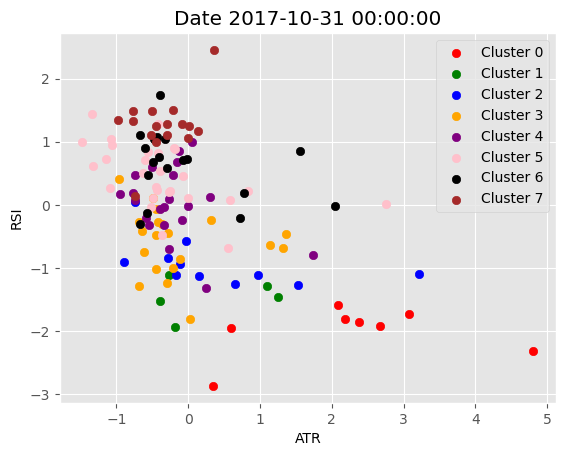

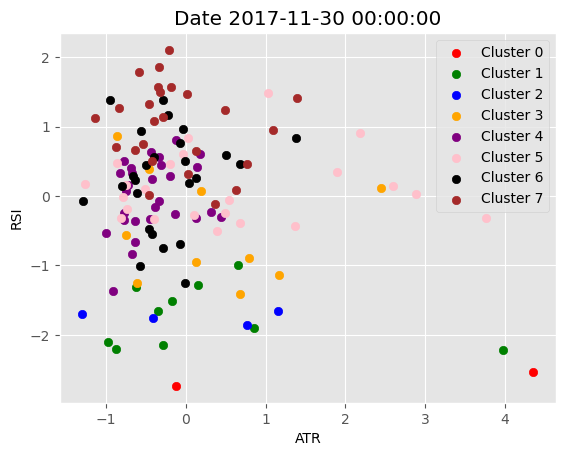

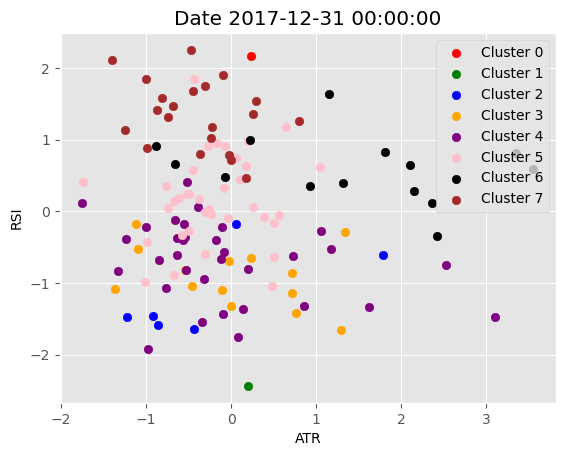

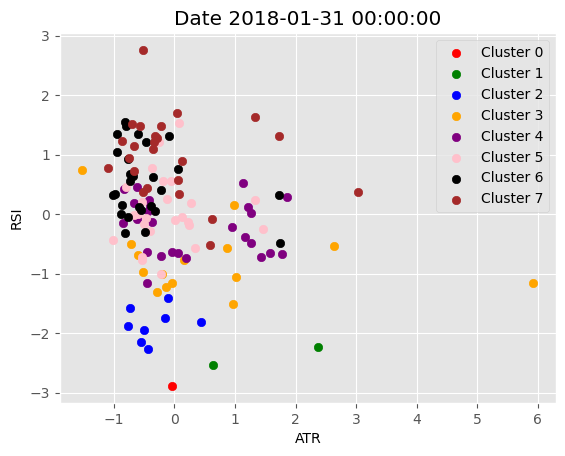

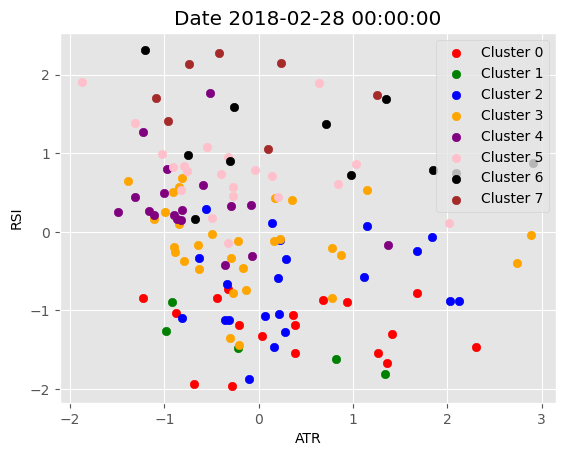

...

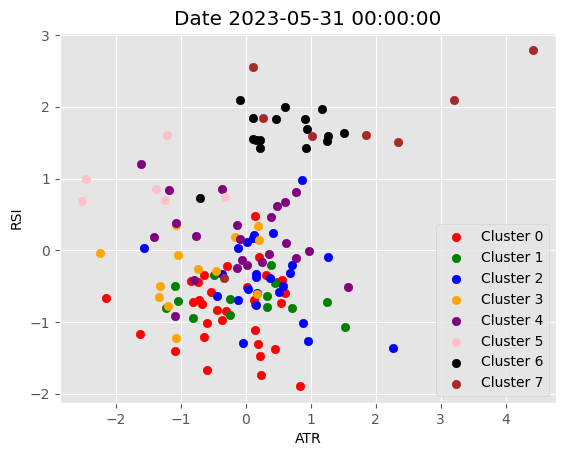

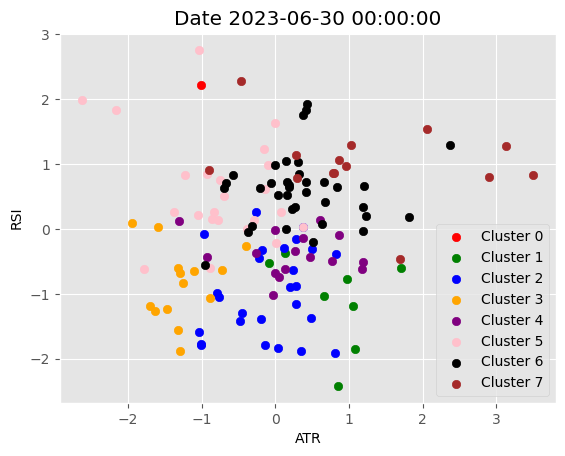

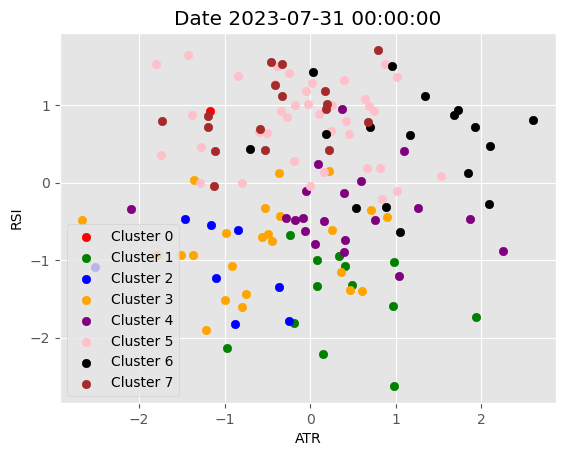

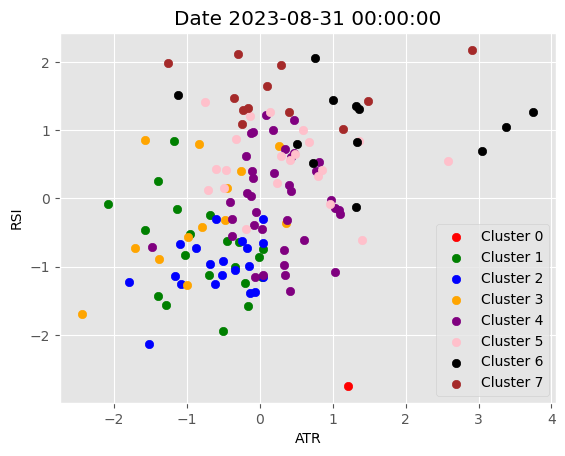

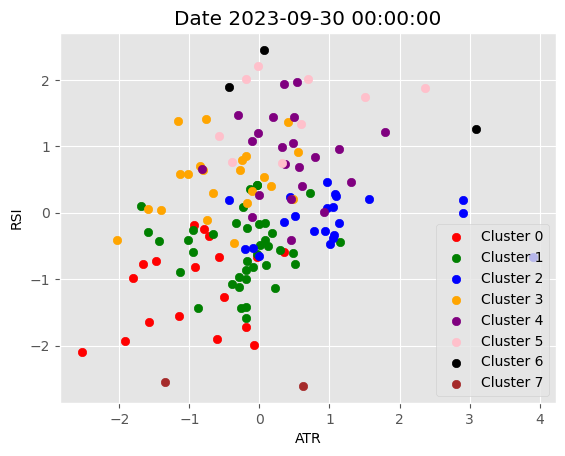

In [27]:
# Plot clusters:
plot_clusters_by_date(num_clusters=8)

In [28]:
# Extract the cluster with the highest mean RSI for each month:
date_to_optimize_8 = extract_highest_rsi_clusters_each_month(num_clusters=8)

{'2017-11-01': ['ADBE', 'AMAT', 'AMZN', 'CAT', 'CRM', 'INTC', 'ISRG', 'MA', 'MAR', 'MU', 'NFLX', 'NVDA', 'PYPL', 'SHW', 'STZ', 'TXN'], '2017-12-01': ['ABBV', 'ADBE', 'AMZN', 'AVGO', 'AZO', 'BA', 'CAT', 'COST', 'DE', 'DG', 'DLTR', 'ELV', 'HD', 'HON', 'ILMN', 'ISRG', 'MAR', 'MMM', 'NKE', 'PYPL', 'QCOM', 'UNH', 'UNP', 'WMT', 'WYNN'], '2018-01-01': ['FCX'], '2018-02-01': ['ABBV', 'ABT', 'ADBE', 'AMZN', 'BA', 'CAT', 'CRM', 'DE', 'DG', 'DLTR', 'EA', 'ISRG', 'LOW', 'MA', 'MAR', 'MSFT', 'NFLX', 'NVDA', 'PYPL', 'TGT', 'TMO', 'TXN', 'V', 'WMT'], '2018-03-01': ['ADBE', 'AMZN', 'BA', 'BKNG', 'LMT', 'MA', 'NFLX'], '2018-04-01': ['COP', 'CSX', 'DAL', 'F', 'NEE', 'SBUX', 'TJX', 'UAL'], '2018-05-01': ['CMG', 'PXD', 'ULTA', 'VLO'], '2018-06-01': ['AMD', 'COP', 'CSX', 'EOG', 'GM', 'INTC', 'MU', 'OXY', 'PANW', 'VLO'], '2018-07-01': ['AMZN', 'CRM', 'EA', 'KR', 'NFLX', 'NKE', 'TJX'], '2018-08-01': ['ABT', 'AMD', 'BMY', 'CSX', 'GILD', 'KR', 'LLY', 'MDLZ', 'MRK', 'PFE', 'WBA'], '2018-09-01': ['AAPL', 'AMD', 

### Set k = 9, RSI values = [30, 35, 40, 45, 50, 55, 60, 65, 70]

In [29]:
# Perform clustering with 9 clusters:
data_9 = perform_clustering(data, 9)

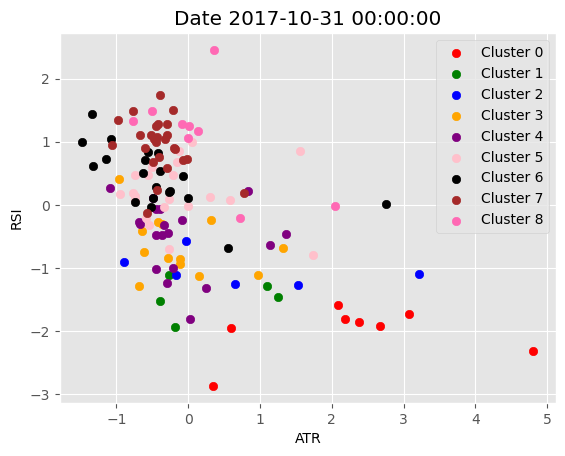

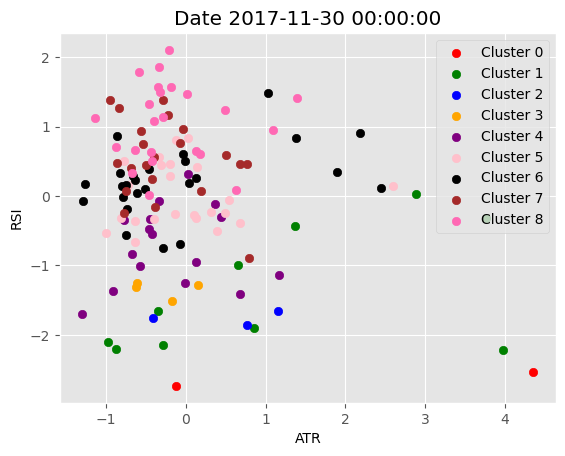

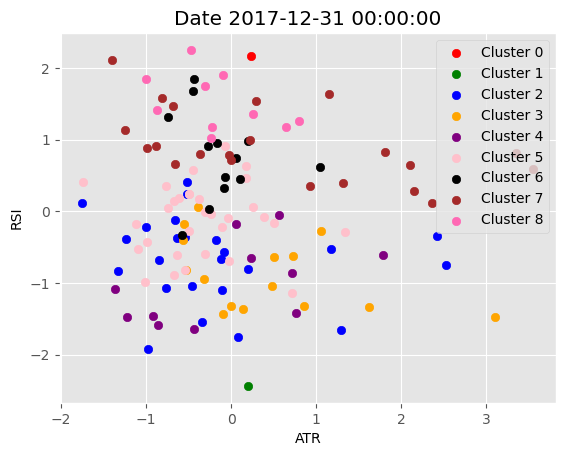

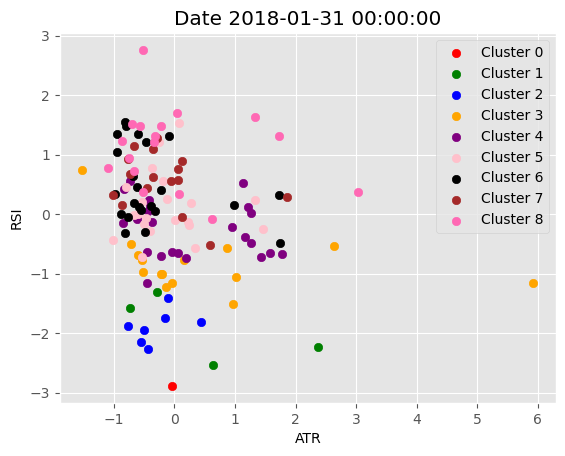

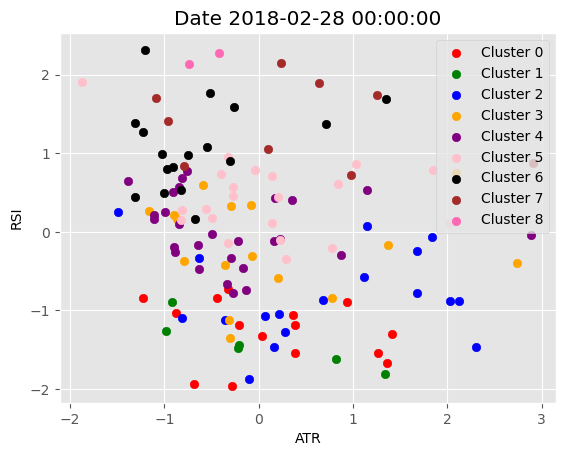

...

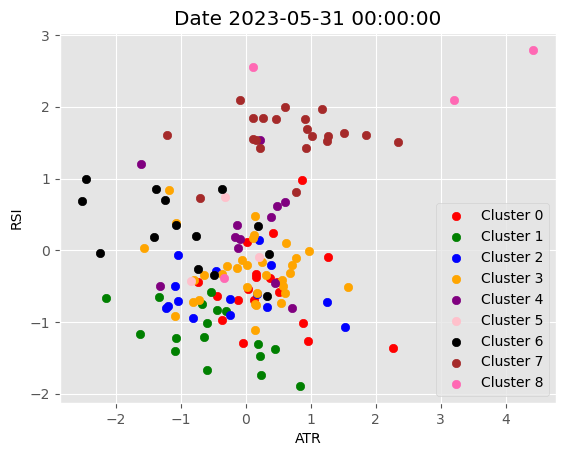

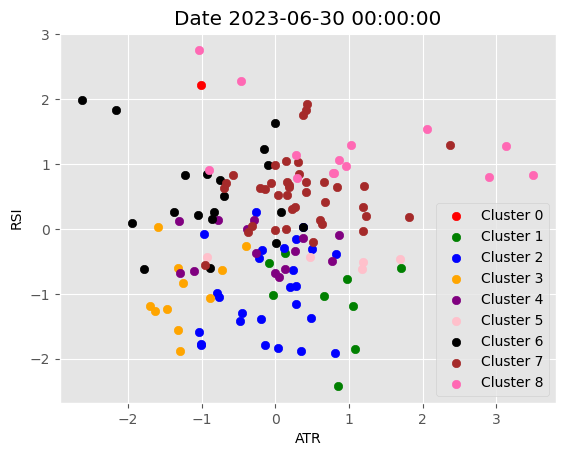

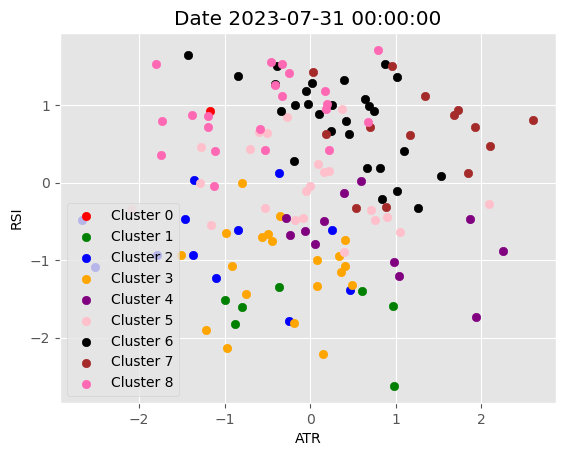

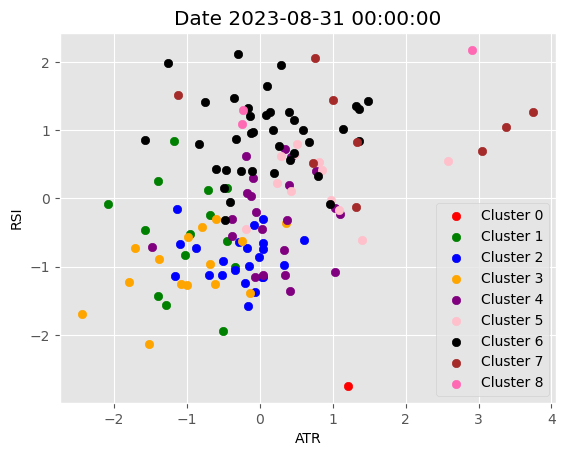

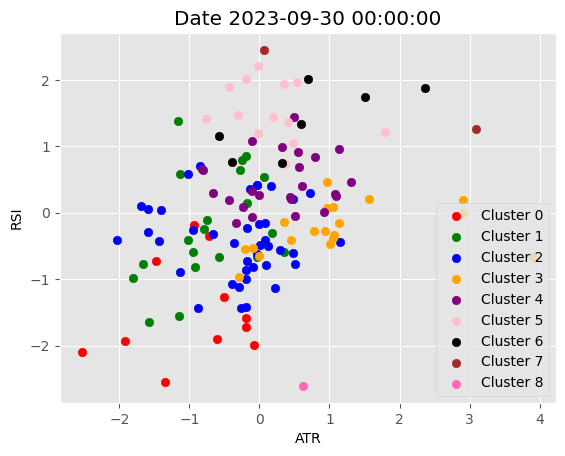

In [30]:
# Plot clusters:
plot_clusters_by_date(num_clusters=9)

In [31]:
# Extract the cluster with the highest mean RSI for each month:
date_to_optimize_9 = extract_highest_rsi_clusters_each_month(num_clusters=9)

{'2017-11-01': ['ABBV', 'AMAT', 'CAT', 'GM', 'INTC', 'MAR', 'MU', 'NVDA', 'PYPL'], '2017-12-01': ['ACN', 'ADBE', 'AVGO', 'AZO', 'BA', 'CAT', 'COST', 'DE', 'DG', 'DLTR', 'ELV', 'HD', 'HON', 'ILMN', 'ISRG', 'MAR', 'MCD', 'MMM', 'QCOM', 'SHW', 'UNH', 'UNP', 'WMT'], '2018-01-01': ['FCX'], '2018-02-01': ['ABBV', 'ADBE', 'AMZN', 'BA', 'CAT', 'CRM', 'DE', 'EA', 'ISRG', 'MA', 'MAR', 'MSFT', 'NFLX', 'NVDA', 'PYPL', 'TMO', 'V'], '2018-03-01': ['AMZN', 'NFLX'], '2018-04-01': ['CL', 'COP', 'CSX', 'F', 'NEE', 'SBUX', 'TJX'], '2018-05-01': ['CMG', 'PXD', 'ULTA', 'VLO'], '2018-06-01': ['AMD', 'COP', 'CSX', 'GM', 'MU', 'OXY', 'VLO'], '2018-07-01': ['AMD', 'AMZN', 'EA', 'KR', 'NFLX', 'NKE', 'TJX'], '2018-08-01': ['AAPL', 'ABT', 'AMD', 'AMZN', 'COP', 'CSX', 'KR', 'LLY', 'MRK', 'MSFT', 'NKE', 'PFE', 'QCOM', 'TGT', 'TJX'], '2018-09-01': ['AAPL', 'AMD', 'AMZN', 'CSCO', 'CSX', 'LOW', 'MPC', 'NKE', 'NVDA', 'PANW', 'PYPL', 'TGT', 'TJX', 'UAL'], '2018-10-01': ['AAPL', 'ABT', 'AMD', 'COP', 'CSCO', 'CVS', 'LLY',

# Portfolio Optimization

In [32]:
# pip install PyPortfolioOpt

In [33]:
from pypfopt.efficient_frontier import EfficientFrontier
import pypfopt.base_optimizer
from pypfopt import risk_models
from pypfopt import expected_returns

def optimize_weights(prices, lower_bound=0):
    """
    Optimize portfolio weights to maximize the Sharpe ratio.
    Parameters:
    - prices (DataFrame or Series): Historical prices of assets.
    - lower_bound (float, optional): Lower bound for asset weights (default is 0).
    Returns:
    - dict: A dictionary of optimized asset weights for the portfolio.
    """
    returns = expected_returns.mean_historical_return(prices=prices, frequency=252)
    cov = risk_models.sample_cov(prices=prices, frequency=252)
    ef = EfficientFrontier(expected_returns=returns, cov_matrix=cov, weight_bounds=(lower_bound, 0.1), solver='SCS')
    weights = ef.max_sharpe()
    
    return ef.clean_weights()

In [34]:
"""
    Optimize the portfolio for a specific month and add the results to the portfolio DataFrame.
    Parameters:
    - portfolio_df (DataFrame): DataFrame to store portfolio optimization results.
    - fixed_dates (dict): A dictionary with dates as keys and lists of selected stocks as values.
    - start_date (str): The start date of the optimization period.
    - returns_dataframe (DataFrame): DataFrame containing asset returns over time.
    - cluster_num (int): The cluster number.
    Returns:
    - DataFrame: Updated portfolio DataFrame.
"""
def optimize_month(portfolio_df, fixed_dates, start_date, returns_dataframe, cluster_num):
    try:
        end_date = (pd.to_datetime(start_date)+pd.offsets.MonthEnd(0)).strftime('%Y-%m-%d')
        cols = fixed_dates[start_date]
        optimization_start_date = (pd.to_datetime(start_date)-pd.DateOffset(months=12)).strftime('%Y-%m-%d')
        optimization_end_date = (pd.to_datetime(start_date)-pd.DateOffset(days=1)).strftime('%Y-%m-%d')
        optimization_df = new_df[optimization_start_date:optimization_end_date]['Adj Close'][cols]
        success = False
        try:
            weights = optimize_weights(prices=optimization_df,
                                   lower_bound=round(1/(len(optimization_df.columns)*2),3))
            weights = pd.DataFrame(weights, index=pd.Series(0))
            success = True
        except:
            print(f'Max Sharpe Optimization failed for {start_date}, Continuing with Equal-Weights')
        
        if success==False:
            weights = pd.DataFrame([1/len(optimization_df.columns) for i in range(len(optimization_df.columns))],
                                     index=optimization_df.columns.tolist(),
                                     columns=pd.Series(0)).T
        
        temp_df = returns_dataframe[start_date:end_date]
        temp_df = temp_df.stack().to_frame('return').reset_index(level=0)\
                   .merge(weights.stack().to_frame('weight').reset_index(level=0, drop=True),
                          left_index=True,
                          right_index=True)\
                   .reset_index().set_index(['Date', 'index']).unstack().stack()
        temp_df.index.names = ['date', 'ticker']
        temp_df['weighted_return'] = temp_df['return']*temp_df['weight']
        col_name = 'Strategy Return_' + str(cluster_num)
        temp_df = temp_df.groupby(level=0)['weighted_return'].sum().to_frame(col_name)
        portfolio_df = pd.concat([portfolio_df, temp_df], axis=0)
    
    except Exception as e:
        print(e)
    return portfolio_df

In [35]:
def optimize_all(dates, new_df, cluster_num):
    """
    Optimize portfolios for all given start dates and cluster number.
    Parameters:
    - dates (dict): A dictionary with dates as keys and lists of selected stocks as values.
    - new_df (DataFrame): DataFrame containing asset data.
    - cluster_num (int): The cluster number.
    Returns:
    - DataFrame: DataFrame with optimized portfolio returns.
    """
    portfolio_df = pd.DataFrame()
    returns_dataframe = np.log(new_df['Adj Close']).diff()
    for start_date in dates.keys():
        portfolio_df = optimize_month(portfolio_df, dates, start_date, returns_dataframe, cluster_num)
    portfolio_df = portfolio_df.drop_duplicates()
    
    return portfolio_df

In [36]:
# import stock data
import yfinance as yf
stocks = data.index.get_level_values('ticker').unique().tolist()
new_df = yf.download(tickers=stocks,
                     start=data.index.get_level_values('date').unique()[0]-pd.DateOffset(months=12),
                     end=data.index.get_level_values('date').unique()[-1])

new_df

[*********************100%%**********************]  152 of 152 completed


Adj Close                                                 \
                  AAL        AAPL        ABBV        ABT         ACN   
Date                                                                   
2016-10-31  39.134331   26.316147   41.009079  34.630016  104.350304   
2016-11-01  38.363213   25.841002   41.501659  34.462341  104.260544   
2016-11-02  38.276463   25.864172   41.751633  34.153461  106.477921   
2016-11-03  38.054207   25.586948   41.089947  33.871056  104.987686   
2016-11-04  38.402096   25.356312   41.200230  34.497635  105.239044   
...               ...         ...         ...        ...         ...   
2023-09-25  12.910000  176.080002  153.117371  96.933411  315.680695   
2023-09-26  12.700000  171.960007  152.384705  95.700241  309.327057   
2023-09-27  12.610000  170.429993  151.612442  95.004089  313.081512   
2023-09-28  12.920000  170.690002  150.741165  97.579834  299.527710   
2023-09-29  12.810000  171.210007  147.582764  96.316818  305.841522   

                                                                       ...  \
                  ADBE         ADP        ADSK        AIG        AMAT  ...   
Date                                                                   ...   
2016-10-31  107.510002   75.138786   72.279999  51.253315   26.757378  ...   
2016-11-01  106.870003   75.017975   70.099998  50.406010   26.591753  ...   
2016-11-02  105.889999   77.658997   68.680000  50.298027   26.306509  ...   
2016-11-03  107.169998   77.097961   67.610001  48.304379   26.012072  ...   
2016-11-04  106.199997   76.882202   69.440002  47.664753   25.966061  ...   
...                ...         ...         ...        ...         ...  ...   
2023-09-25  511.600006  240.020004  205.669998  62.130001  136.589996  ...   
2023-09-26  506.299988  237.240005  201.660004  61.259998  134.080002  ...   
2023-09-27  502.600006  242.630005  202.279999  61.009998  135.059998  ...   
2023-09-28  504.670013  243.309998  207.889999  61.279999  138.220001  ...   
2023-09-29  509.899994  240.580002  206.910004  60.599998  138.449997  ...   

              Volume                                                           \
                   V      VLO     VRTX        VZ       WBA      WDC       WFC   
Date                                                                            
2016-10-31  10024000  4969500  1928200  12459400   4662100  3363200  20115900   
2016-11-01  10881500  7816800  2458200  13229400   5130800  3821100  20020200   
2016-11-02   9170900  7317600  2580400  16488200   9783100  4216200  19566600   
2016-11-03   7563100  3855900  2371000  12605100   4586500  3192600  14982700   
2016-11-04   7588100  3729900  1902100  14410200   7023900  2705600  27391600   
...              ...      ...      ...       ...       ...      ...       ...   
2023-09-25   5921600  3241900   698100  17616900   6891000  2685900  10624000   
2023-09-26   6193200  4936800   633600  18841600   7570500  3571100  15219400   
2023-09-27   6006700  3644000   860600  22083500  10182900  2547800  11815500   
2023-09-28   4203900  3587300   578900  18772100   7291500  3282000  12454600   
2023-09-29   6044200  4302200   896800  19759400  25659100  2512000  13119100   

                                        
                WMT     WYNN       XOM  
Date                                    
2016-10-31  6389000  1341600  16663800  
2016-11-01  8838600  3722300  13050600  
2016-11-02  7645300  2542400  11226100  
2016-11-03  6803900  9050400   8836500  
2016-11-04  7262100  3223800  13877100  
...             ...      ...       ...  
2023-09-25  3486500  1387800  11316000  
2023-09-26  4811900  1454000  11805400  
2023-09-27  5237000  2050000  23976200  
2023-09-28  3872400  1290400  16808100  
2023-09-29  6279300  1326800  18810700  

[1740 rows x 912 columns]

In [52]:
# optimize portfolio for k = 3 clustering strategy
optimize_cluster_3 = optimize_all(date_to_optimize_3, new_df, 3)
optimize_cluster_3

Max Sharpe Optimization failed for 2020-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2021-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2022-08-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2022-09-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2022-10-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2023-03-01, Continuing with Equal-Weights
'return'


,Strategy Return_3
date,
2017-11-01,0.002189
2017-11-02,0.003534
2017-11-03,0.004561
2017-11-06,0.003459
2017-11-07,0.002191
...,...
2023-09-25,0.003640
2023-09-26,-0.011765
2023-09-27,0.007309


In [53]:
# optimize portfolio for k = 4 clustering strategy
optimize_cluster_4 = optimize_all(date_to_optimize_4, new_df, 4)
portfolio_optimize_4 = pd.merge(optimize_cluster_3, optimize_cluster_4, left_index = True, right_index = True)
portfolio_optimize_4

Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-07-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-11-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-02-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-07-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-09-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-12-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2021-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2021-02-01, Continuing with Equal-Weights

,Strategy Return_3,Strategy Return_4
date,,
2017-11-01,0.002189,0.003315
2017-11-02,0.003534,-0.001932
2017-11-03,0.004561,0.007616
2017-11-06,0.003459,0.000406
2017-11-07,0.002191,0.004128
...,...,...
2023-09-25,0.003640,0.003030
2023-09-26,-0.011765,-0.013295
2023-09-27,0.007309,0.005964


In [54]:
# optimize portfolio for k = 5 clustering strategy
optimize_cluster_5 = optimize_all(date_to_optimize_5, new_df, 5)
portfolio_optimize_5 = pd.merge(portfolio_optimize_4, optimize_cluster_5, left_index = True, right_index = True)
portfolio_optimize_5

Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-11-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-10-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-02-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-07-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-09-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-12-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2021-01-01, Continuing with Equal-Weights

,Strategy Return_3,Strategy Return_4,Strategy Return_5
date,,,
2017-11-01,0.002189,0.003315,0.002706
2017-11-02,0.003534,-0.001932,0.003078
2017-11-03,0.004561,0.007616,0.005586
2017-11-06,0.003459,0.000406,0.003862
2017-11-07,0.002191,0.004128,0.001684
...,...,...,...
2023-09-25,0.003640,0.003030,0.005480
2023-09-26,-0.011765,-0.013295,-0.012497
2023-09-27,0.007309,0.005964,0.006429


In [55]:
# optimize portfolio for k = 6 clustering strategy
optimize_cluster_6 = optimize_all(date_to_optimize_6, new_df, 6)
portfolio_optimize_6 = pd.merge(portfolio_optimize_5, optimize_cluster_6, left_index = True, right_index = True)
portfolio_optimize_6

Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-07-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-11-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-02-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-08-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-10-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-02-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-03-01, Continuing with Equal-Weights

,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6
date,,,,
2017-11-01,0.002189,0.003315,0.002706,0.004600
2017-11-02,0.003534,-0.001932,0.003078,0.000594
2017-11-03,0.004561,0.007616,0.005586,0.007479
2017-11-06,0.003459,0.000406,0.003862,0.002738
2017-11-07,0.002191,0.004128,0.001684,0.003365
...,...,...,...,...
2023-09-25,0.003640,0.003030,0.005480,0.002029
2023-09-26,-0.011765,-0.013295,-0.012497,-0.011722
2023-09-27,0.007309,0.005964,0.006429,0.004478


In [56]:
# optimize portfolio for k = 7 clustering strategy
optimize_cluster_7 = optimize_all(date_to_optimize_7, new_df, 7)
portfolio_optimize_7 = pd.merge(portfolio_optimize_6, optimize_cluster_7, left_index = True, right_index = True)
portfolio_optimize_7

Max Sharpe Optimization failed for 2018-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-11-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-09-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-02-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-06-01, Continuing with Equal-Weights

,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6,Strategy Return_7
date,,,,,
2017-11-01,0.002189,0.003315,0.002706,0.004600,0.004371
2017-11-02,0.003534,-0.001932,0.003078,0.000594,0.000656
2017-11-03,0.004561,0.007616,0.005586,0.007479,0.007947
2017-11-06,0.003459,0.000406,0.003862,0.002738,0.000244
2017-11-07,0.002191,0.004128,0.001684,0.003365,0.003602
...,...,...,...,...,...
2023-09-25,0.003640,0.003030,0.005480,0.002029,0.000035
2023-09-26,-0.011765,-0.013295,-0.012497,-0.011722,-0.010398
2023-09-27,0.007309,0.005964,0.006429,0.004478,0.007323


In [57]:
# optimize portfolio for k = 8 clustering strategy
optimize_cluster_8 = optimize_all(date_to_optimize_8, new_df, 8)
portfolio_optimize_8 = pd.merge(portfolio_optimize_7, optimize_cluster_8, left_index = True, right_index = True)
portfolio_optimize_8

Max Sharpe Optimization failed for 2018-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-07-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-11-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-02-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-08-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-09-01, Continuing with Equal-Weights

,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6,Strategy Return_7,Strategy Return_8
date,,,,,,
2017-11-01,0.002189,0.003315,0.002706,0.004600,0.004371,0.000957
2017-11-02,0.003534,-0.001932,0.003078,0.000594,0.000656,0.000036
2017-11-03,0.004561,0.007616,0.005586,0.007479,0.007947,0.006981
2017-11-06,0.003459,0.000406,0.003862,0.002738,0.000244,0.002295
2017-11-07,0.002191,0.004128,0.001684,0.003365,0.003602,0.003050
...,...,...,...,...,...,...
2023-09-25,0.003640,0.003030,0.005480,0.002029,0.000035,0.001021
2023-09-26,-0.011765,-0.013295,-0.012497,-0.011722,-0.010398,-0.012210
2023-09-27,0.007309,0.005964,0.006429,0.004478,0.007323,0.004670


In [58]:
# optimize portfolio for k = 9 clustering strategy
optimize_cluster_9 = optimize_all(date_to_optimize_9, new_df, 9)
portfolio_optimize_final = pd.merge(portfolio_optimize_8, optimize_cluster_9, left_index = True, right_index = True)
portfolio_optimize_final

Max Sharpe Optimization failed for 2017-11-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-07-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-11-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-12-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-02-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-06-01, Continuing with Equal-Weights

,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6,Strategy Return_7,Strategy Return_8,Strategy Return_9
date,,,,,,,
2017-11-01,0.002189,0.003315,0.002706,0.004600,0.004371,0.000957,0.005704
2017-11-02,0.003534,-0.001932,0.003078,0.000594,0.000656,0.000036,-0.002391
2017-11-03,0.004561,0.007616,0.005586,0.007479,0.007947,0.006981,0.003161
2017-11-06,0.003459,0.000406,0.003862,0.002738,0.000244,0.002295,0.003953
2017-11-07,0.002191,0.004128,0.001684,0.003365,0.003602,0.003050,0.002932
...,...,...,...,...,...,...,...
2023-09-25,0.003640,0.003030,0.005480,0.002029,0.000035,0.001021,0.003947
2023-09-26,-0.011765,-0.013295,-0.012497,-0.011722,-0.010398,-0.012210,0.000441
2023-09-27,0.007309,0.005964,0.006429,0.004478,0.007323,0.004670,-0.000166


In [59]:
# Retrieve SPY returns data
spy = yf.download(tickers='SPY',
                  start='2015-01-01',
                  end=dt.date.today())
spy_ret = np.log(spy[['Adj Close']]).diff().dropna().rename({'Adj Close':'SPY Buy&Hold'}, axis=1)
portfolio_optimize_final = portfolio_optimize_final.merge(spy_ret, left_index=True, right_index=True)
portfolio_optimize_final

[*********************100%%**********************]  1 of 1 completed


,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6,Strategy Return_7,Strategy Return_8,Strategy Return_9,SPY Buy&Hold
2017-11-01,0.002189,0.003315,0.002706,0.004600,0.004371,0.000957,0.005704,0.001321
2017-11-02,0.003534,-0.001932,0.003078,0.000594,0.000656,0.000036,-0.002391,0.000388
2017-11-03,0.004561,0.007616,0.005586,0.007479,0.007947,0.006981,0.003161,0.003333
2017-11-06,0.003459,0.000406,0.003862,0.002738,0.000244,0.002295,0.003953,0.001546
2017-11-07,0.002191,0.004128,0.001684,0.003365,0.003602,0.003050,0.002932,-0.000695
...,...,...,...,...,...,...,...,...
2023-09-25,0.003640,0.003030,0.005480,0.002029,0.000035,0.001021,0.003947,0.004196
2023-09-26,-0.011765,-0.013295,-0.012497,-0.011722,-0.010398,-0.012210,0.000441,-0.014800
2023-09-27,0.007309,0.005964,0.006429,0.004478,0.007323,0.004670,-0.000166,0.000399
2023-09-28,0.009581,0.010577,0.009309,0.009152,0.009185,0.006302,-0.000159,0.005781


In [60]:
# function to calculate geometric mean returns
def calculate_geo_mean(df):
    geo_mean = (df+1).prod()**(1/df.shape[0]) - 1
    return geo_mean

# function to calculate annualized volatility 
def calculate_annul_vol(df):
    annul_vol = df.std()*np.sqrt(252)
    return annul_vol

def calculate_downside_std_dev(df):
    downside_diff = np.clip(df, np.NINF, 0) # remove positive returns 
    np.square(downside_diff, out=downside_diff)
    annualized_downside_std_dev = np.sqrt(downside_diff.mean()) * np.sqrt(252)

    return annualized_downside_std_dev

# function to calculate annulized returns
def calculate_annul_ret(df):
    returns_per_day = calculate_geo_mean(df)
    annul_ret = (returns_per_day+1)**252-1
    return annul_ret

# function to calculate max % drawdown
def calculate_max_drawdown(return_series): 
    wealth_index = (1+return_series).cumprod()
    previous_peaks = wealth_index.cummax()
    drawdowns = (wealth_index - previous_peaks) / previous_peaks
    return drawdowns.min()

# def calculate_beta(daily_portfolio_returns, daily_benchmark_returns, risk_free_rate=0.02):
#     risk_free_rate = riskfree_rate*np.sqrt(252) # convert to daily
#     excess_returns = daily_portfolio_returns - risk_free_rate
#     excess_benchmark_returns = daily_benchmark_returns - risk_free_rate
#     beta = np.cov(excess_returns, excess_benchmark_returns)[0, 1] / np.var(excess_benchmark_returns)
#     return beta

# def calculate_alpha(anul_portfolio_returns, anul_benchmark_returns, beta, riskfree_rate=0.02):
#     return anul_portfolio_returns - (riskfree_rate + beta*(anul_benchmark_returns - riskfree_rate))

# function to calculate sharpe ratio
def calculate_sharpe_ratio(annualized_return, annualized_vol, riskfree_rate=0.02):
    return (annualized_return - riskfree_rate)/annualized_vol
    
# function to calculate calmar ratio
def calculate_calmar_ratio(annualized_return, max_drawdown, riskfree_rate=0.02):
    return (annualized_return - riskfree_rate)/max_drawdown

# function to calculate sortino ratio
def calculate_sortino_ratio(annualized_return, annualized_downside_std_dev, riskfree_rate = 0.02):
    return (annualized_return - riskfree_rate)/annualized_downside_std_dev

In [61]:
# Create a list of 'k' values
k_values = [3, 4, 5, 6, 7, 8, 9]

# Create a dictionary to store the metrics
metrics_dict = {}

# Loop through the 'k' values
for k in k_values:
    strategy_return = portfolio_optimize_final[f'Strategy Return_{k}']
    
    # Calculate metrics
    anul_vol = calculate_annul_vol(strategy_return)
    downside_std_dev = calculate_downside_std_dev(strategy_return)
    anul_ret = calculate_annul_ret(strategy_return)
    max_pct_drawdown = calculate_max_drawdown(strategy_return)
    sharpe_ratio = calculate_sharpe_ratio(anul_ret, anul_vol)
    sortino_ratio = calculate_sortino_ratio(anul_ret, downside_std_dev)
    calmar_ratio = calculate_calmar_ratio(anul_ret, max_pct_drawdown)

    # Store metrics in the dictionary
    metrics_dict[f'k = {k}'] = [anul_ret, anul_vol, downside_std_dev, max_pct_drawdown, sharpe_ratio, sortino_ratio, abs(calmar_ratio)]

# Calculate metrics for 'SPY Buy & Hold' strategy
spy_return = portfolio_optimize_final['SPY Buy&Hold']
anul_vol_spy = calculate_annul_vol(spy_return)
downside_std_dev_spy = calculate_downside_std_dev(spy_return)
anul_ret_spy = calculate_annul_ret(spy_return)
max_pct_drawdown_spy = calculate_max_drawdown(spy_return)
sharpe_ratio_spy = calculate_sharpe_ratio(anul_ret_spy, anul_vol_spy)
sortino_ratio_spy = calculate_sortino_ratio(anul_ret_spy, downside_std_dev_spy)
calmar_ratio_spy = calculate_calmar_ratio(anul_ret_spy, max_pct_drawdown_spy)

# Store metrics for 'SPY Buy & Hold' in the dictionary
metrics_dict['SPY Buy & Hold'] = [anul_ret_spy, anul_vol_spy, downside_std_dev_spy, max_pct_drawdown_spy, sharpe_ratio_spy, sortino_ratio_spy, abs(calmar_ratio_spy)]

# # Print the metrics
# for key, values in metrics_dict.items():
#     print(key)
#     print(f"Annualized Vol: {values[1]}")
#     print(f"Annualized Downside Vol: {values[2]}")
#     print(f"Annualized Ret: {values[0]}")
#     print(f"Max % Drawdown: {values[3]}")
#     print(f"Annualized Sharpe Ratio: {values[4]}")
#     print(f"Annualized Sortino Ratio: {values[5]}")
#     print(f"Annualized Calmar Ratio: {values[6]}")
#     print('------------------------------------------------')


In [62]:
# create DataFrame to store values for better visualization
metrics_df = pd.DataFrame(metrics_dict, index = ['Annualized Returns',
                                                 'Annualized Volatility',
                                                 'Downside Standard Dev',
                                                 'Max % Drawdown',
                                                 'Sharpe Ratio',
                                                 'Sortino Ratio',
                                                 'Calmar Ratio'])

metrics_df

,k = 3,k = 4,k = 5,k = 6,k = 7,k = 8,k = 9,SPY Buy & Hold
Annualized Returns,0.045060,0.144383,0.204065,0.241837,0.167783,0.186481,0.202034,0.085671
Annualized Volatility,0.235926,0.313810,0.337998,0.348629,0.335167,0.353781,0.375393,0.204864
Downside Standard Dev,0.175158,0.224091,0.239229,0.243015,0.240216,0.248220,0.258742,0.150440
Max % Drawdown,-0.352544,-0.403325,-0.377897,-0.370571,-0.374851,-0.387648,-0.447836,-0.357459
Sharpe Ratio,0.106220,0.396363,0.544575,0.636313,0.440923,0.470576,0.484914,0.320558
Sortino Ratio,0.143070,0.555054,0.769410,0.912854,0.615209,0.670698,0.703533,0.436526
Calmar Ratio,0.071083,0.308393,0.487079,0.598635,0.394245,0.429464,0.406473,0.183716


<Axes: >

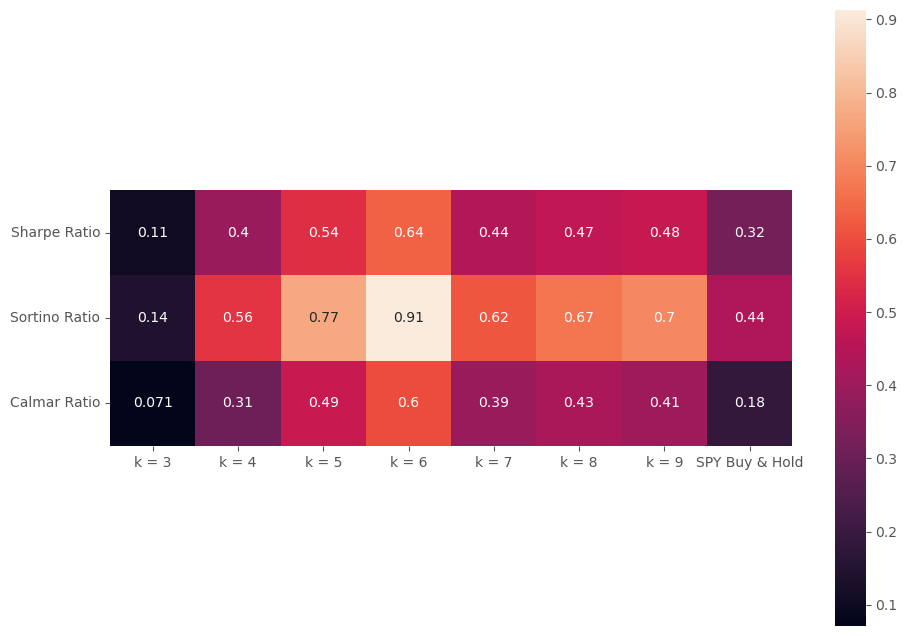

In [63]:
# Show a heatmap of ratios
plt.figure(figsize = (11,8))
sns.heatmap(metrics_df.loc['Sharpe Ratio':'Calmar Ratio',:], annot=True, square = True)

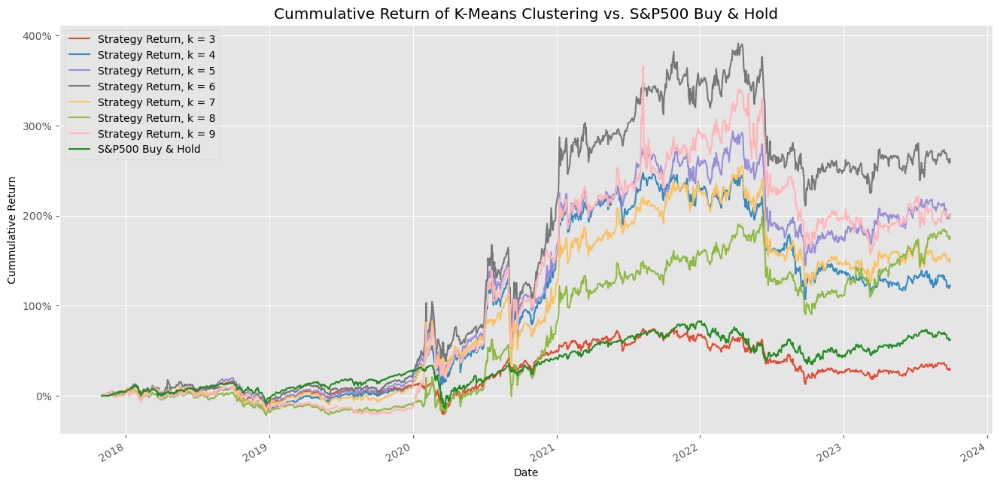

In [85]:
# Create a list of 'k' values
k_values = [3, 4, 5, 6, 7, 8, 9]

# Plot cumulative returns for each portfolio
for k in k_values:
    portfolio_return = portfolio_optimize_final[f'Strategy Return_{k}']
    portfolio_cumulative_return = np.exp(np.log1p(portfolio_return).cumsum()) - 1
    portfolio_cumulative_return.plot(fontsize = 10, figsize=(16, 8), label=f'Strategy Return, k = {k}')

# Plot cumulative returns for 'SPY Buy & Hold' portfolio
spy_return = portfolio_optimize_final['SPY Buy&Hold']
spy_cumulative_return = np.exp(np.log1p(spy_return).cumsum()) - 1
spy_cumulative_return.plot(fontsize = 10, figsize=(16, 8), label='S&P500 Buy & Hold', color='forestgreen')

plt.title('Cummulative Return of K-Means Clustering vs. S&P500 Buy & Hold')
plt.legend(fontsize='10', loc = 'upper left')
plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter(1))
plt.ylabel('Cummulative Return')
plt.xlabel('Date')

plt.show()

In [71]:
# Define the Excel file name
excel_file = 'k=6.xlsx'

# Save the DataFrame to an Excel file
portfolio_optimize_6.to_excel(excel_file)